In [87]:
import sys
print(sys.version)

3.7.0 (default, Jun 28 2018, 08:04:48) [MSC v.1912 64 bit (AMD64)]


In [62]:
# DATA 준비
# 20201008
#---- to do list -----
# err_data_list 파일자동화

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

from tensorflow.python.keras.optimizer_v2.rmsprop import RMSProp
from math import sqrt
from numpy import concatenate
from matplotlib import pyplot
from pandas import read_csv, DataFrame, concat
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense, RepeatVector, LSTM, Input, TimeDistributed, Activation, Dropout
from keras.optimizers import SGD
np.set_printoptions(suppress=True)

#pow 낮값만 추출 test
#pow = 0인 구간 : 0~4, 21-23시
powhr_start = 5
powhr_end   = 20

shift_days  = 3
hoursteps   = powhr_end-powhr_start+1 #(16)
timesteps   = shift_days*hoursteps #hours step

data_dim    = 15
out_dim     = 1

n_model    = 10

season_mod = 'all_1030_f9'
date_start = '10190901'
date_end   = '30191201'

err_date_list = ['20190912',
                    '20191122',
                    '20191130',
                    '20191217',
                    '20200501',
                    '20200502',
                    '20191028',
                    '20191107',
                    '20191108',
                    '20191109',
                    '20191110',
                    '20191111',
                    '20191112',
                    '20200214',
                    '20200307',
                    '20200308',
                    '20200309',
                    '20200310',
                    '20200328',
                    '20200329',
                    '20200625',
                    '20200809']

# Yeo-JohnsonTransformer

In [100]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import PowerTransformer 

def yeo_johnson_transform(dataset):
    
    column_trans = ColumnTransformer(
                    [('sunshine', PowerTransformer(method='yeo-johnson', standardize=True), ['sunshine']),
                     ('humdt', PowerTransformer(method='yeo-johnson', standardize=True), ['humdt']),
                     ('wnd_spd', PowerTransformer(method='yeo-johnson', standardize=True), ['wnd_spd']),
                     ('visiblt', PowerTransformer(method='yeo-johnson', standardize=True), ['visiblt']),
                     ('cloud2', PowerTransformer(method='yeo-johnson', standardize=True), ['cloud2']),
                     ('cloud', PowerTransformer(method='yeo-johnson', standardize=True), ['cloud']),
                     ('grd_temprt', PowerTransformer(method='yeo-johnson', standardize=True), ['grd_temprt']),
                     ('wnd_dir', PowerTransformer(method='yeo-johnson', standardize=True), ['wnd_dir']),
                     ('dewpnt', PowerTransformer(method='yeo-johnson', standardize=True), ['dewpnt']),
                     ('steampressr', PowerTransformer(method='yeo-johnson', standardize=True), ['steampressr']),
                     ('temprt', PowerTransformer(method='yeo-johnson', standardize=True), ['temprt']),
                     ('mincloud', PowerTransformer(method='yeo-johnson', standardize=True), ['mincloud']),
                     ('rain', PowerTransformer(method='yeo-johnson', standardize=True), ['rain']),
                     ('pressr', PowerTransformer(method='yeo-johnson', standardize=True), ['pressr']),
                     ('seapressr', PowerTransformer(method='yeo-johnson', standardize=True), ['seapressr']),
                     ('snow', PowerTransformer(method='yeo-johnson', standardize=True), ['snow'])
                    ])

    transformed_yeojohnson = column_trans.fit_transform(dataset)
    yeojohnson_df = pd.DataFrame(transformed_yeojohnson, columns=dataset.columns)
    pd.concat([yeojohnson_df], axis = 1)
                    
    return yeojohnson_df

# Get weather, pow data

In [101]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import fnmatch
from pandas import read_csv
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import PowerTransformer 
#from feature_engine import variable_transformers as vt
from scipy.stats import yeojohnson

#############################################
# 태양광 전력
#############################################
def get_pow():

    # pow 파일 load
    dir_path    = "C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/data/pow_24/UR00000126_csv"
    file_list   = os.listdir(dir_path)
    print(len(file_list))
    hrPow  = []    

    # pow측정값 에러가 큰 일자 제거
    for filename in file_list:
        if (filename[:-4] not in err_date_list):
            if ((filename[:-4]>=date_start) & (filename<date_end)):
                filedata = pd.read_csv(dir_path+'/'+filename).values[:,0]
                hrPow.append(filedata)
                
    #낮시간 추출 (5~20시)
    pow_dataset = pd.DataFrame(hrPow)
    pow_dataset =pow_dataset.iloc[:,powhr_start:powhr_end+1]
    pow_dataset.to_csv("C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/data/pow_hr.csv",mode='w',index=False)

    # 결측값 보간, reshape
    pow_dataset = pow_dataset.interpolate(method='linear')
    pow_dataset = pow_dataset.values.reshape(-1,1)
    pow_dataset = pd.DataFrame(pow_dataset)
    pow_dataset.columns = ['pow']
    pow_dataset.to_csv("C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/data/pow2.csv",mode='w',index=False)

    
    # scale
    sc_pow = MinMaxScaler(feature_range = (0, 1))
    scaled_pow = sc_pow.fit_transform(pow_dataset.values)
    df_pow = pd.DataFrame(scaled_pow, columns=pow_dataset.columns, index=list(pow_dataset.index.values))
    
    return df_pow, sc_pow

#############################################
# 종관기상관측
#############################################
def get_weather():
    # pow 파일 load
    dir_path    = "C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/DATA"
    file_list   = os.listdir(dir_path)
    print(len(file_list))
    for filename in os.listdir(dir_path):
        if fnmatch.fnmatch(filename, 'OBS_ASOS_TIM_*.csv'):
            print(filename)

            # load csv data
            dataset = read_csv(dir_path+'/'+filename, encoding='CP949')
            dataset.drop(['지점','지점명'], axis=1, inplace=True)
            dataset.drop(['기온 QC플래그','강수량 QC플래그','풍속 QC플래그','풍향 QC플래그','습도 QC플래그'], axis=1, inplace=True)
            dataset.drop(['현지기압 QC플래그','해면기압 QC플래그','일조 QC플래그','지면온도 QC플래그'], axis=1, inplace=True)
            dataset.drop(['5cm 지중온도(°C)','10cm 지중온도(°C)','20cm 지중온도(°C)','30cm 지중온도(°C)'], axis=1, inplace=True)
            dataset.drop(['3시간신적설(cm)','일사(MJ/m2)','운형(운형약어)','지면상태(지면상태코드)','현상번호(국내식)'], axis=1, inplace=True)

            # set column name
            dataset.columns = ['ymdhms', 'temprt', 'rain', 'wnd_spd', 'wnd_dir', 'humdt','steampressr',
                               'dewpnt', 'pressr','seapressr','sunshine','snow','cloud','cloud2','mincloud','visiblt','grd_temprt']

            # prioirty sort (피어슨상관계수)
            dataset = dataset[['ymdhms','sunshine','humdt','wnd_spd','visiblt','cloud2',
                               'cloud','grd_temprt','wnd_dir','dewpnt','steampressr','temprt',
                               'mincloud','rain','pressr','seapressr','snow']]


            # set NA data (관측값 0이 누적되어 결측된 경우. 0으로 세팅)
            dataset['rain'].fillna(0, inplace=True)     #강수량
            dataset['sunshine'].fillna(0, inplace=True) #일조
            dataset['snow'].fillna(0, inplace=True)     #적설량

            #일시 패턴 변환(2019-08-20 5:00 -> 2019082005)
            dataset['ymdhms'] = dataset['ymdhms'].str[0:4]+dataset['ymdhms'].str[5:7]+dataset['ymdhms'].str[8:10]+dataset['ymdhms'].str[11:13]
            # pow측정값 중 결측값 많은 일자 제거
            dataset = dataset[(dataset['ymdhms'].str[0:8]>=date_start) & (dataset['ymdhms'].str[0:8]<date_end)]
            for err_date in err_date_list:
                idx_err = dataset[dataset['ymdhms'].str.startswith(err_date)].index
                dataset = dataset.drop(idx_err)

            #낮시간 추출 (5~20시)
            dataset = dataset[(dataset['ymdhms'].str[-2:]>=str(powhr_start).rjust(2, '0')) &(dataset['ymdhms'].str[-2:]<=str(powhr_end))]
            dataset = dataset.interpolate(method='linear')# 결측값 보간
            
            # save file (test용)
            dataset.to_csv("C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/DATA/weather2.csv",mode='w',index=False)

            # normalization
            dataset.drop(['ymdhms'], axis=1, inplace=True)
            dataset = dataset.astype('float32')
            dataset = dataset.interpolate(method='linear')
            
            #*********************** YEO - JOHNSON TRANSFORMATION TEST
            yeo_df = yeo_johnson_transform(dataset)
            
            #insert feature (test)
            yeo_df.insert(2, 'temp_press', yeo_df['temprt']-yeo_df['steampressr'], True)
            yeo_df.insert(2, 'sunshine_humdt', abs(yeo_df['sunshine'])-(yeo_df['humdt']*(2.1)), True)#0.35
            
            sc = MinMaxScaler(feature_range = (0, 1))#scale
            scaled_weather = sc.fit_transform(yeo_df.values)
            weather = pd.DataFrame(scaled_weather, columns=yeo_df.columns, index=list(yeo_df.index.values))
            
            weather = weather.iloc[:, 0:data_dim] #feature size 조절
            
    return weather

#############################################
# numpy data 만들기
#############################################
# load weather, pow dataset

df_pow, sc_pow   = get_pow()
df               = get_weather()

df.insert(0, 'pow', df_pow.values, True)
print("******************************************* test ")
#df.insert(1, 'root_pow', df['pow']**(1/2), True)
#f.insert(1, 'log_pow', np.log1p(df['pow']), True)


df.to_csv("C:/Users/VISLAB_PHY/Desktop/WORKSPACE/Origin/data/dataset_p2.csv",mode='w',index=False, encoding='CP949')

337
18
OBS_ASOS_TIM_20200929025447.csv
******************************************* test 


c:\users\vislab_phy\anaconda3\envs\py37\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\vislab_phy\anaconda3\envs\py37\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\vislab_phy\anaconda3\envs\py37\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\vislab_phy\anaconda3\envs\py37\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


## 1. raw data

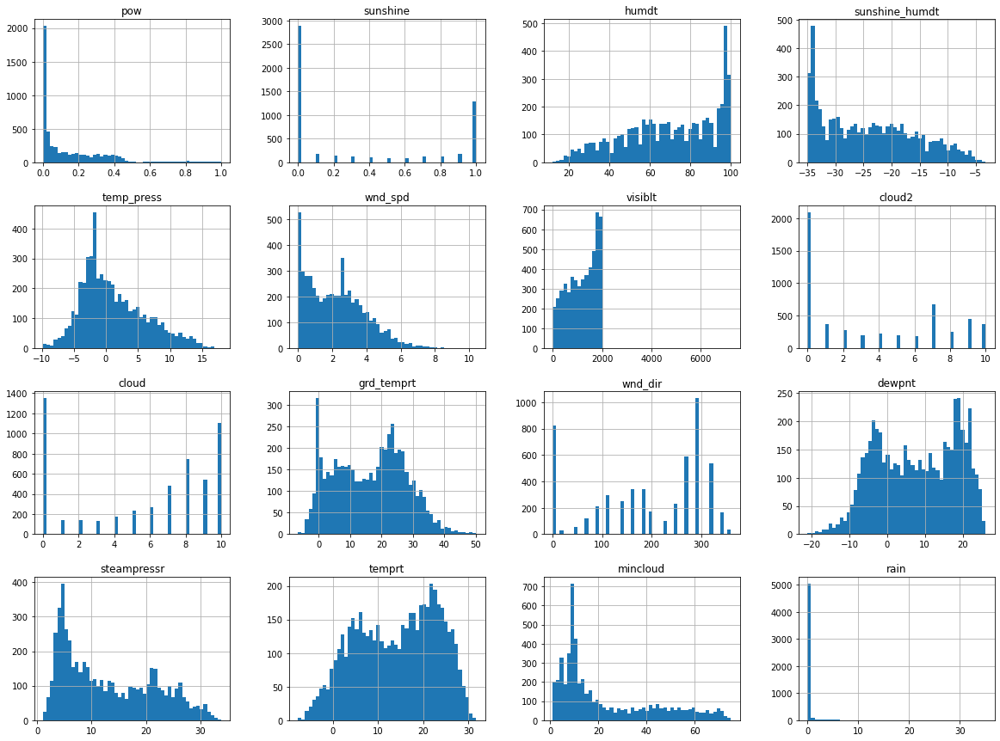

In [70]:
df.hist(bins=50, figsize=(20, 15))
plt.show()

In [91]:
corr = df.corr(method = 'pearson') 
display(corr.iloc[0:1,:])

,pow,sunshine,sunshine_humdt,temp_press,humdt,wnd_spd,visiblt,cloud2,cloud,grd_temprt,wnd_dir,dewpnt,steampressr,temprt,mincloud
pow,1.0,0.687319,0.547353,0.543055,-0.544562,0.386582,0.34384,-0.334067,-0.350742,0.253527,0.250018,-0.21961,-0.221819,0.098566,0.193947


## 4. Yeo-Johnson & scale

In [102]:
corr = df.corr(method = 'pearson') 
display(corr.iloc[0:1,:])

,pow,sunshine,humdt,sunshine_humdt,temp_press,wnd_spd,visiblt,cloud2,cloud,grd_temprt,wnd_dir,dewpnt,steampressr,temprt,mincloud,rain
pow,1.0,0.673997,-0.538137,0.565856,0.57824,0.382138,0.344628,-0.344354,-0.349265,0.242764,0.258348,-0.218046,-0.220661,0.101869,0.239844,-0.197986


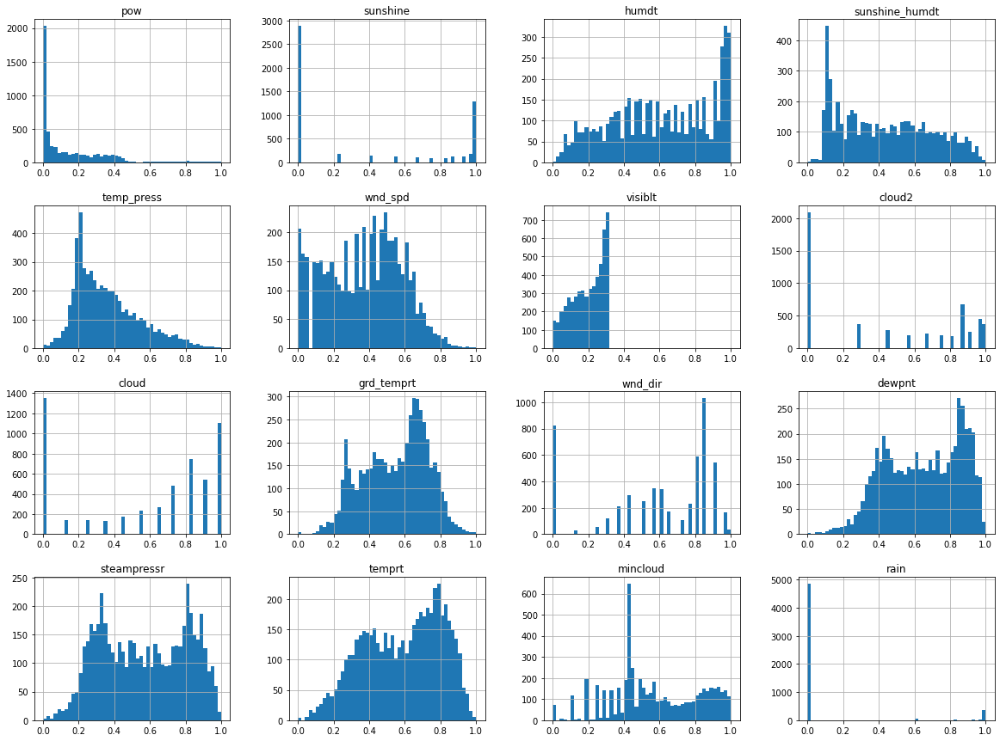

In [103]:
df.hist(bins=50, figsize=(20, 15))
plt.show()

## 2. scale

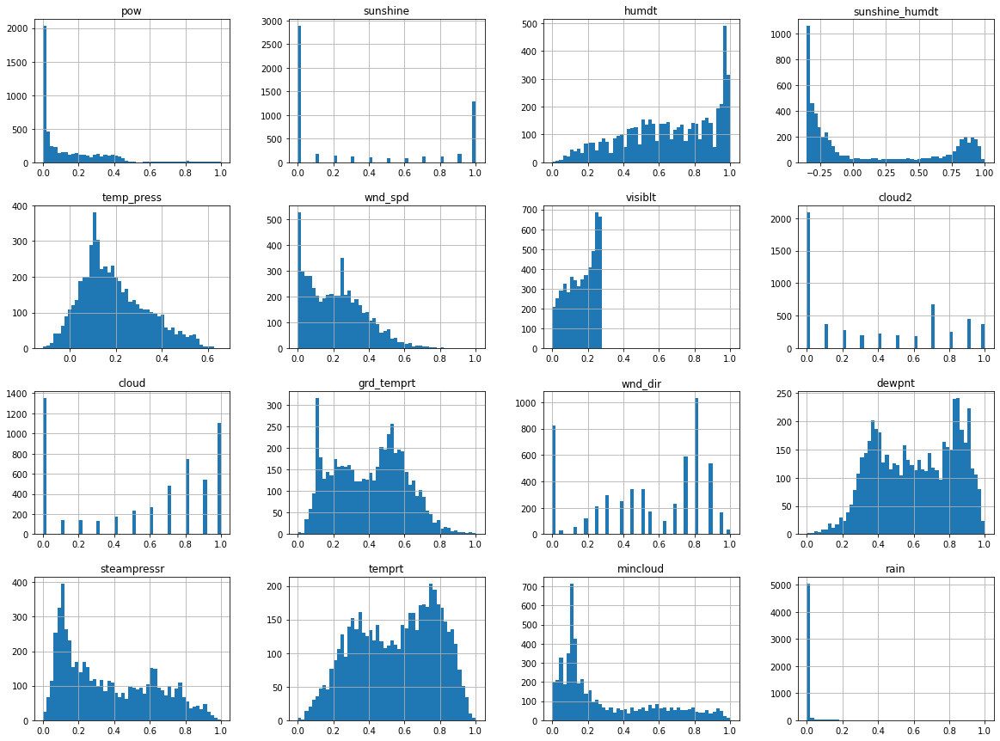

In [76]:
df.hist(bins=50, figsize=(20, 15))
plt.show()

## 3. Yeo-Johnson

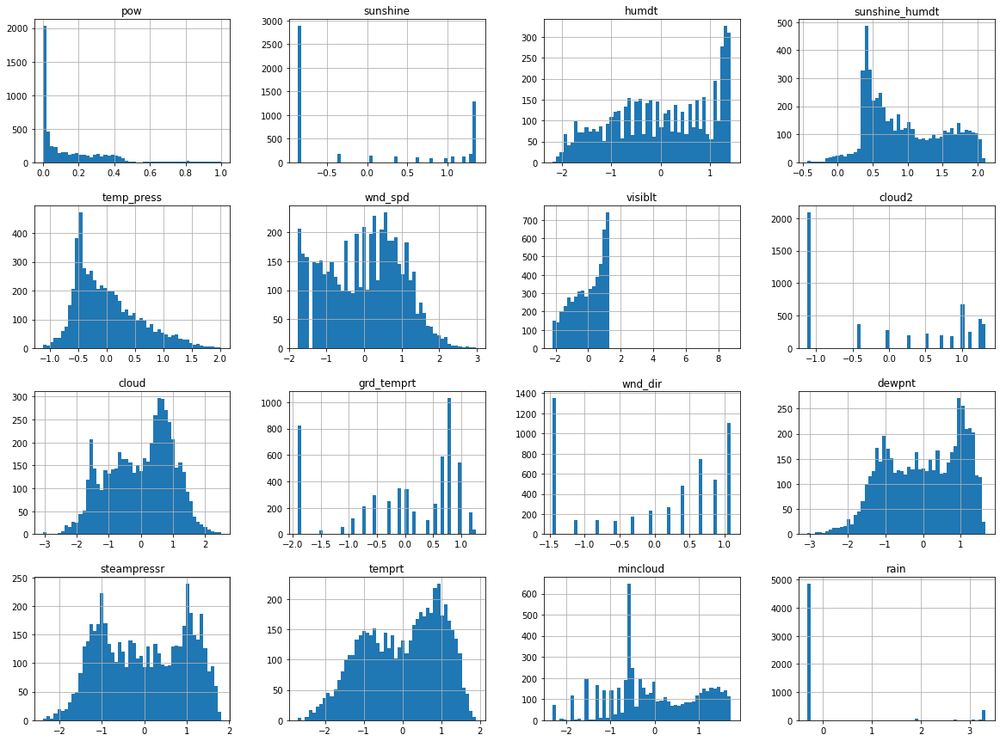

In [79]:
df.hist(bins=50, figsize=(20, 15))
plt.show()

data_dim :  15 , idx :  4
************************************************************************************************************************


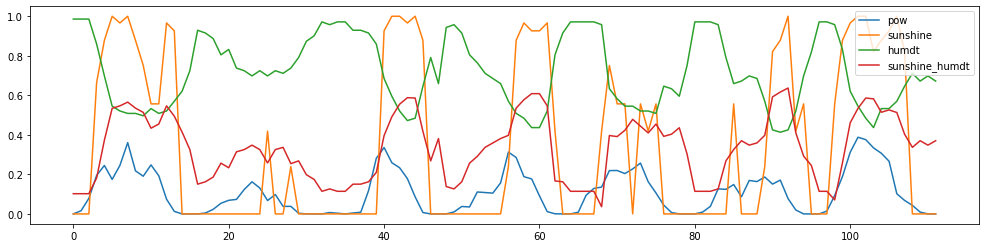

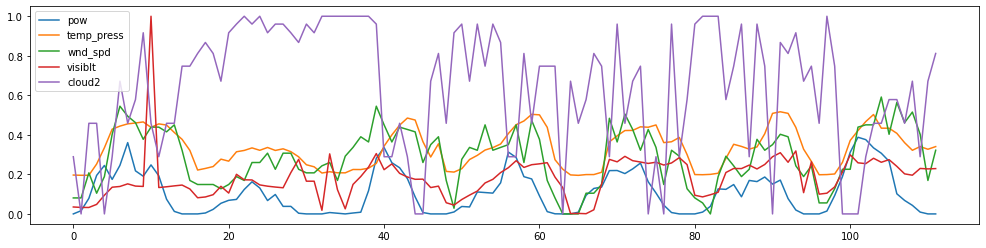

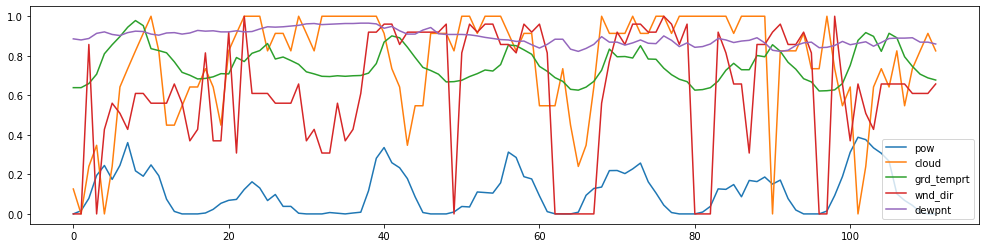

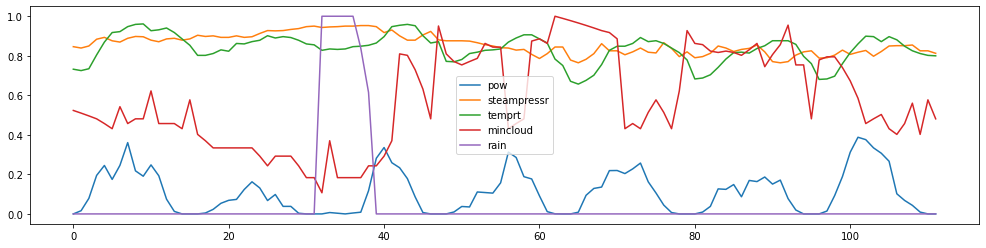

************************************************************************************************************************


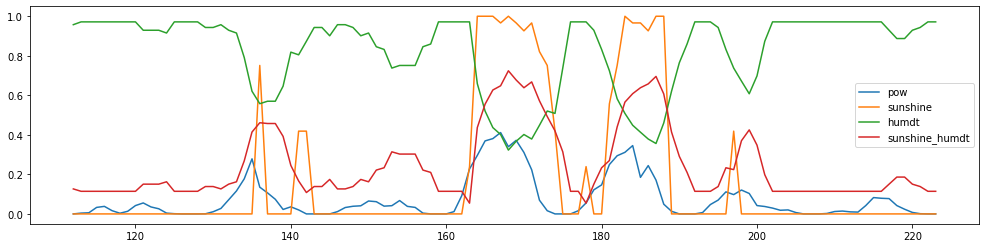

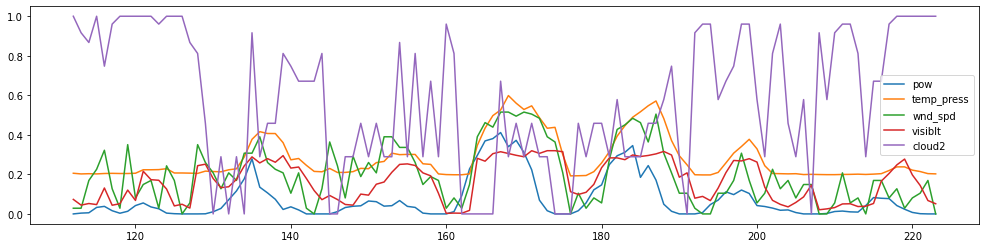

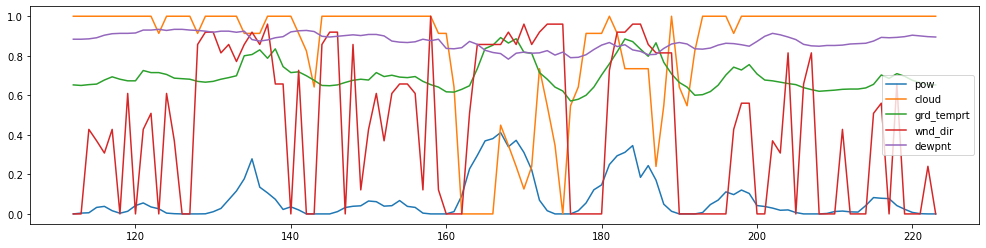

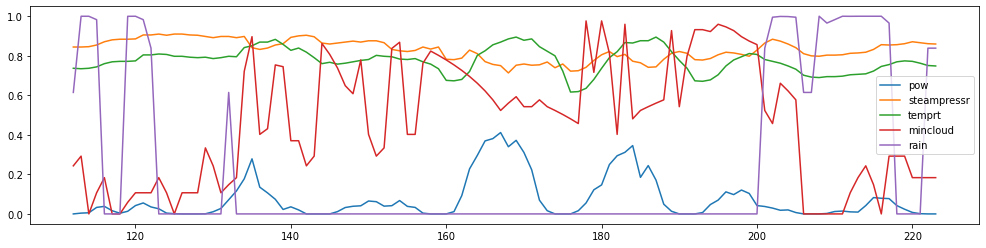

************************************************************************************************************************


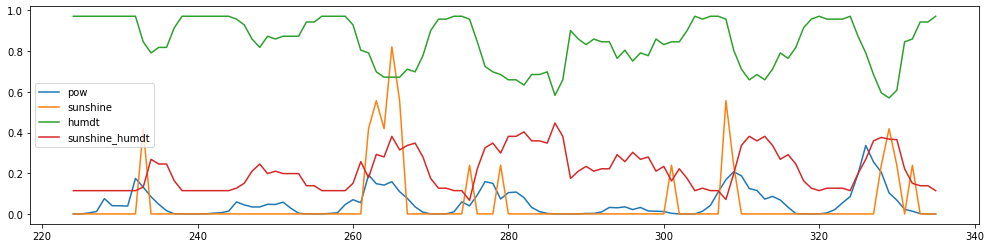

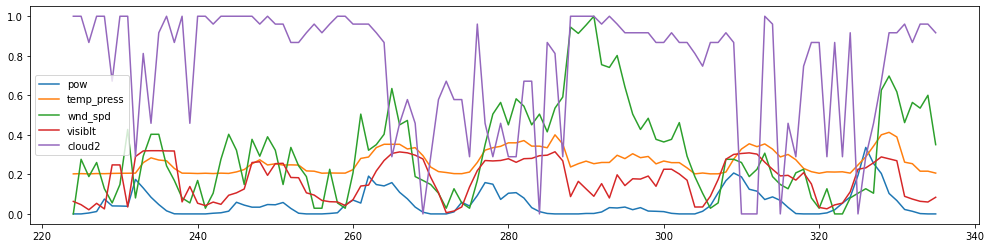

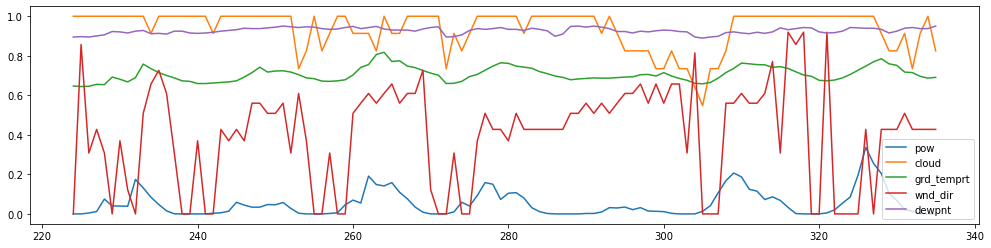

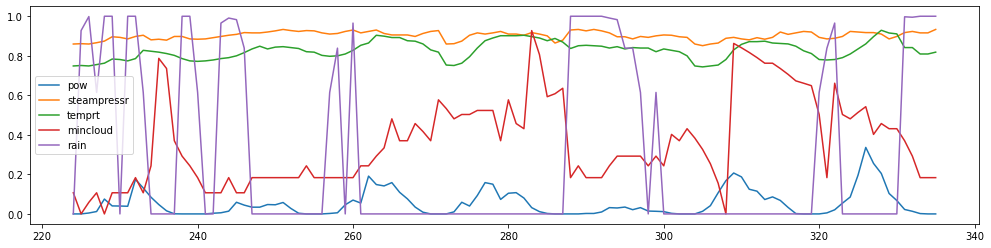

************************************************************************************************************************


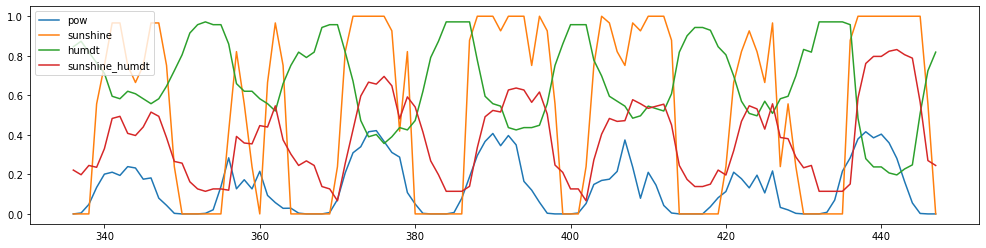

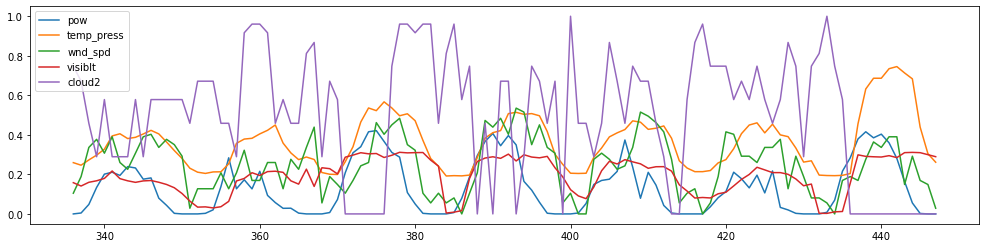

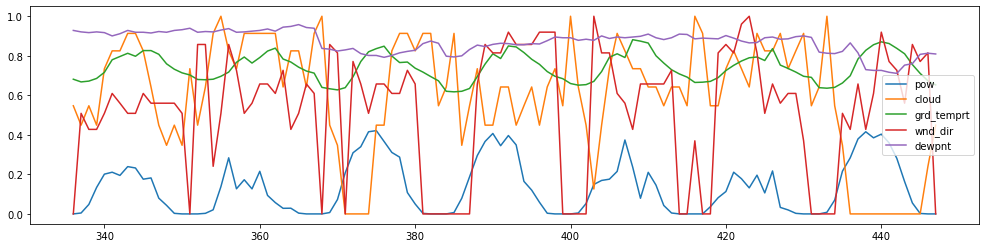

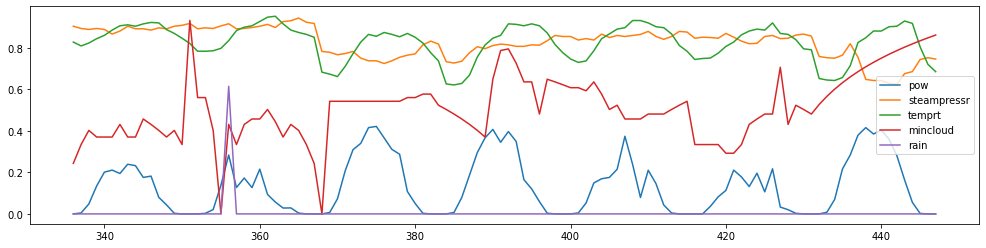

************************************************************************************************************************


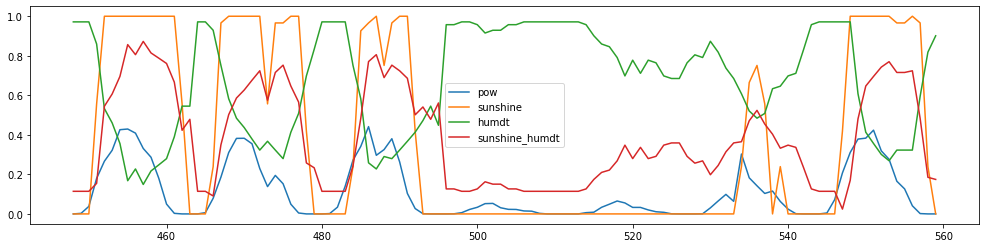

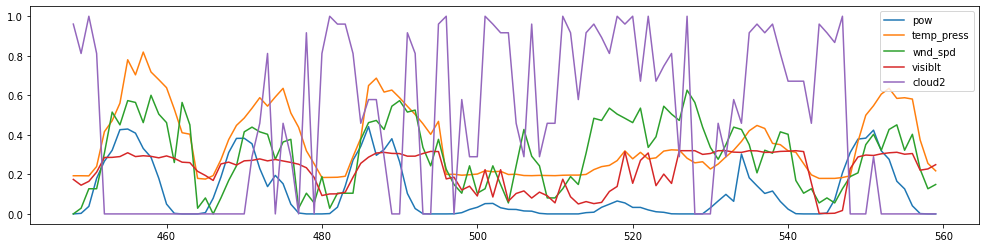

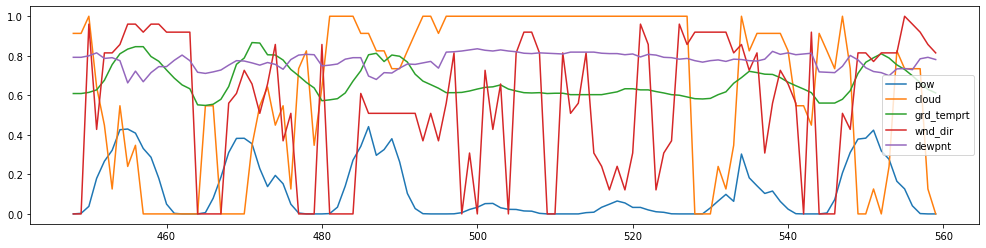

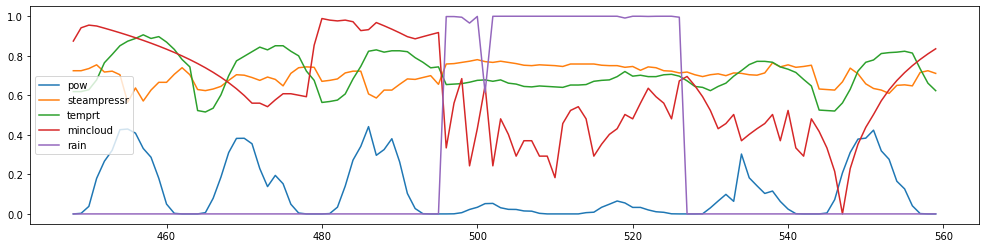

************************************************************************************************************************


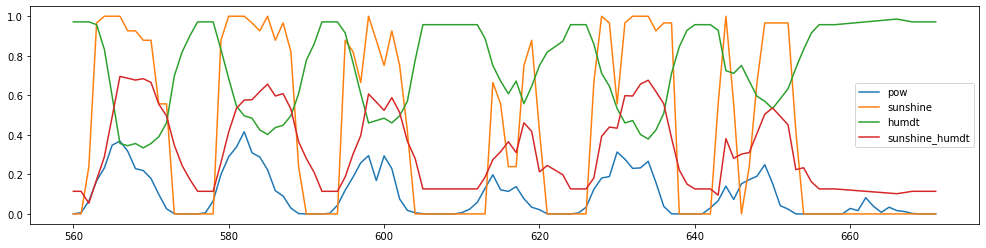

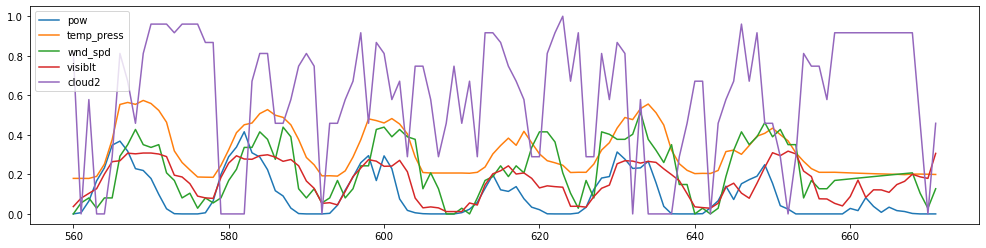

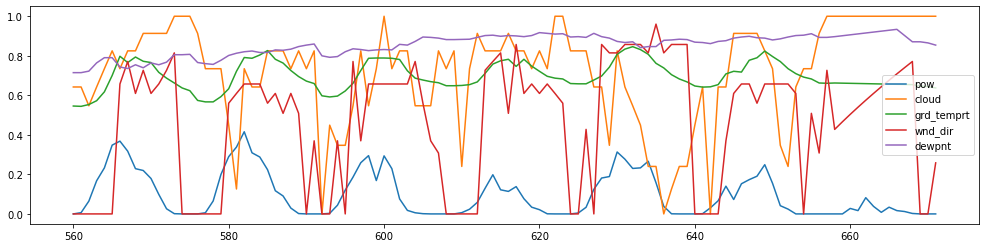

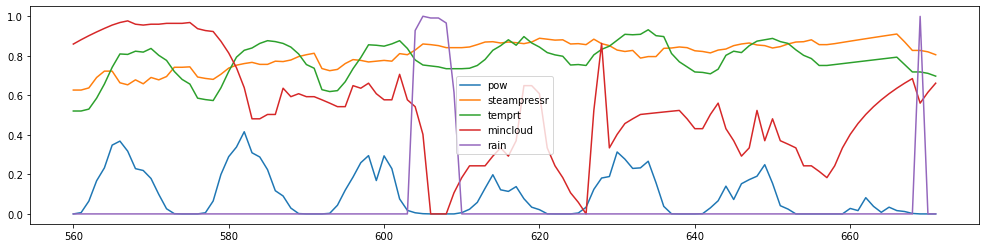

************************************************************************************************************************


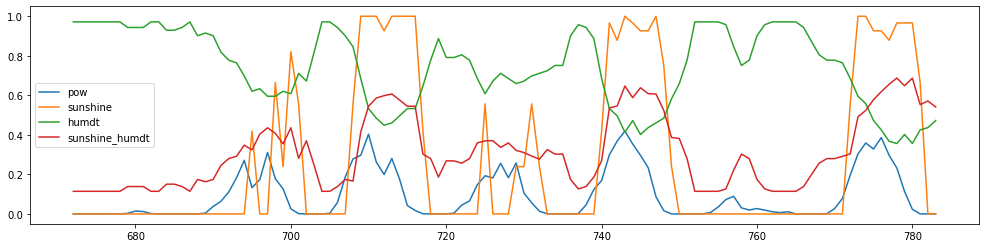

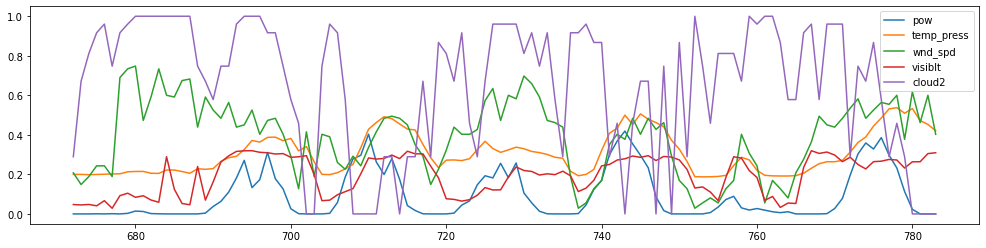

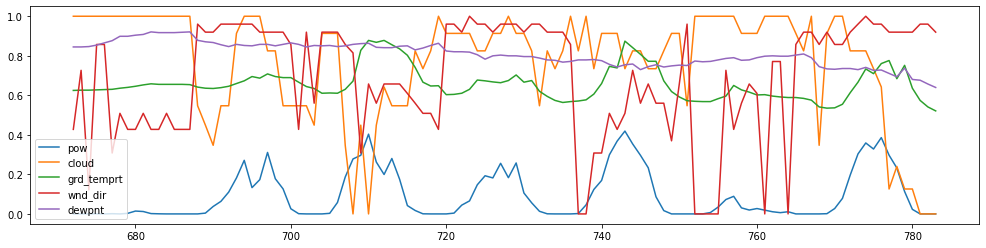

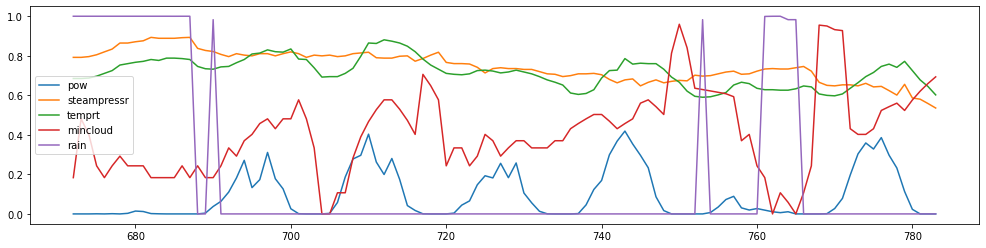

************************************************************************************************************************


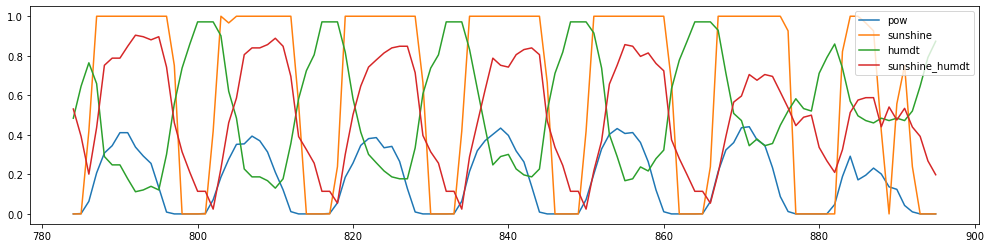

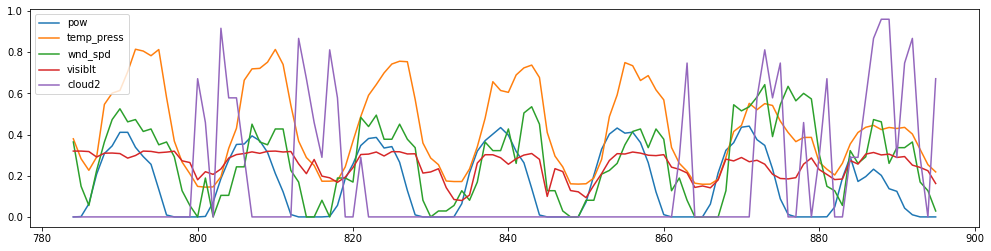

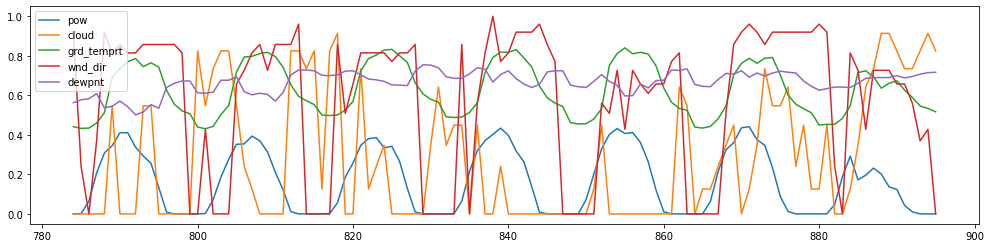

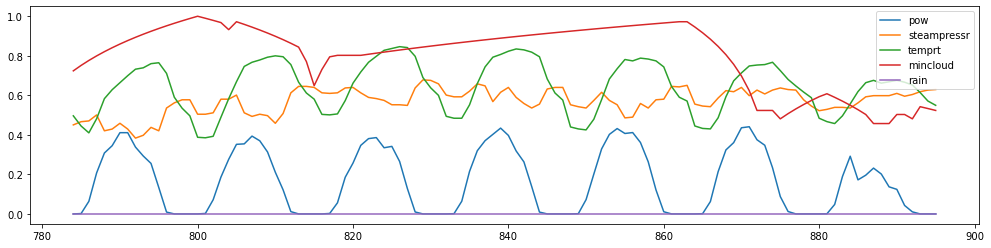

************************************************************************************************************************


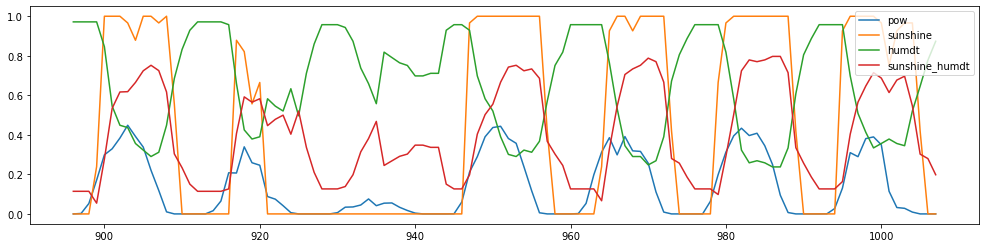

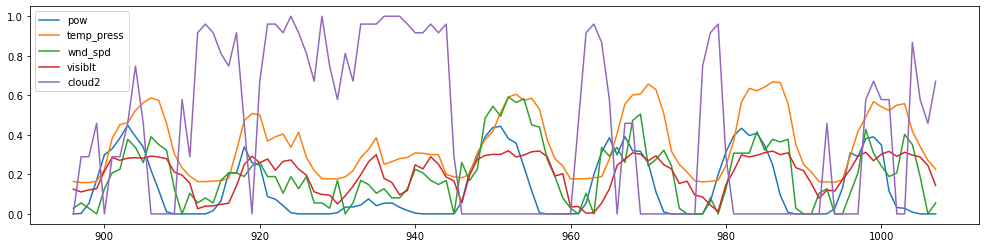

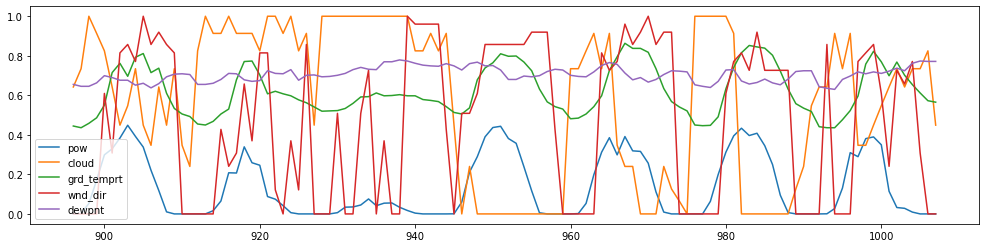

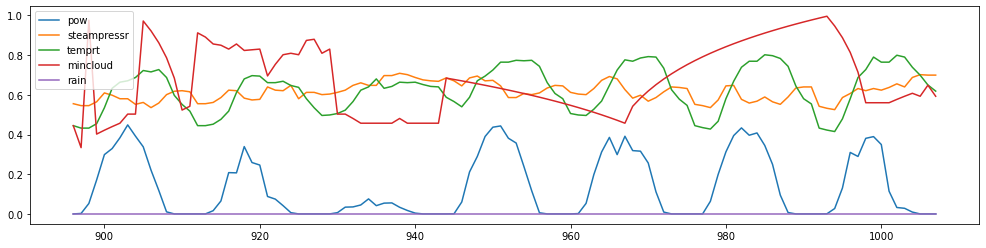

************************************************************************************************************************


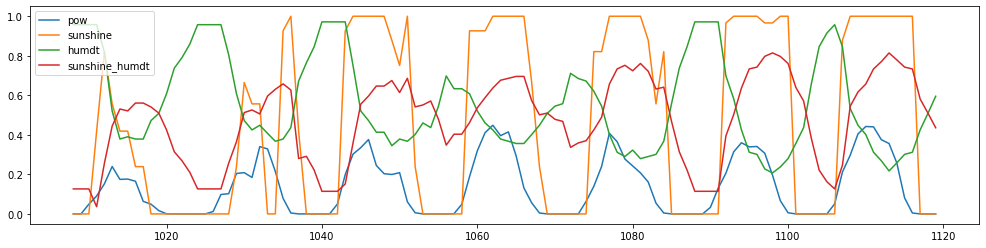

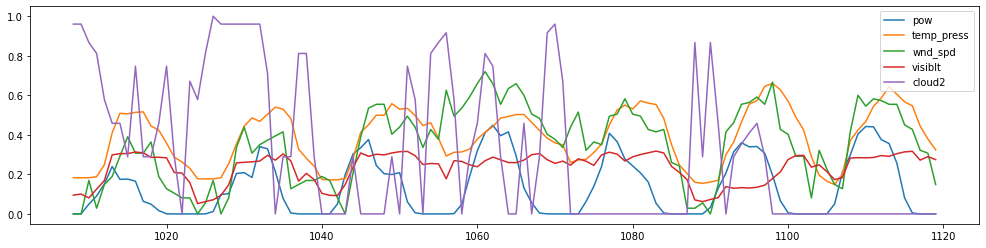

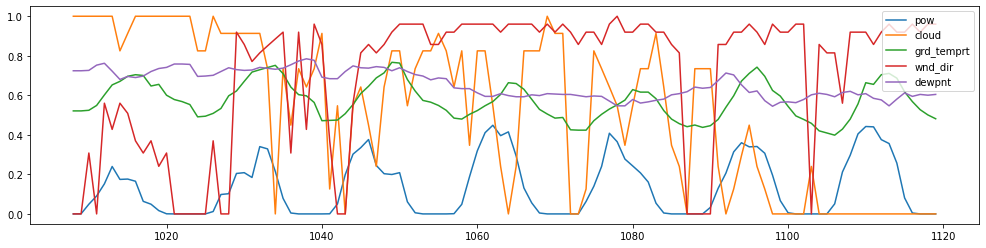

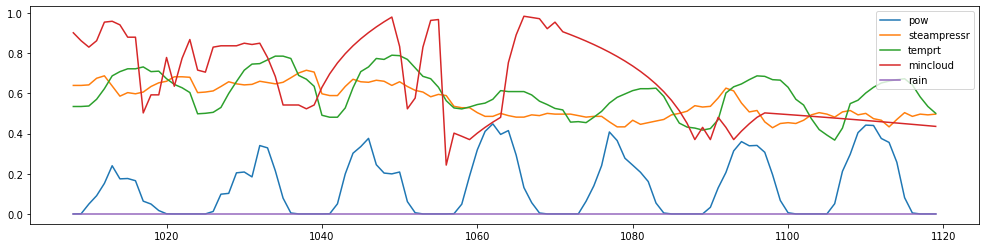

************************************************************************************************************************


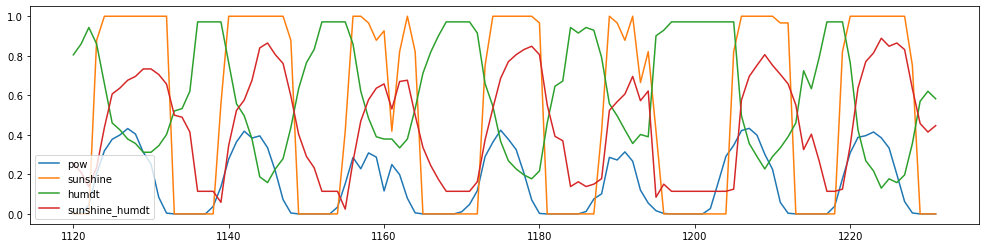

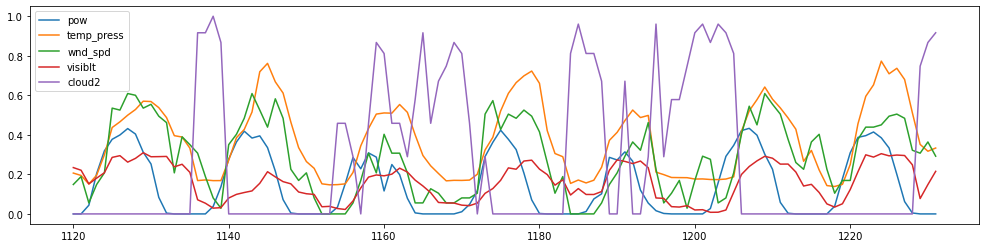

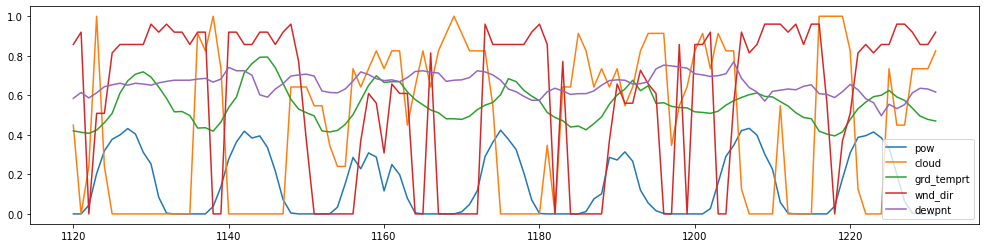

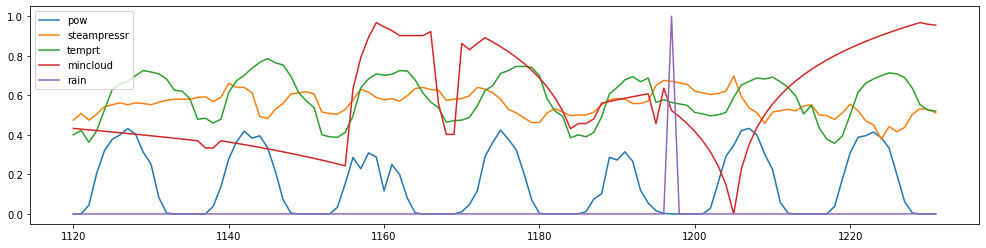

************************************************************************************************************************


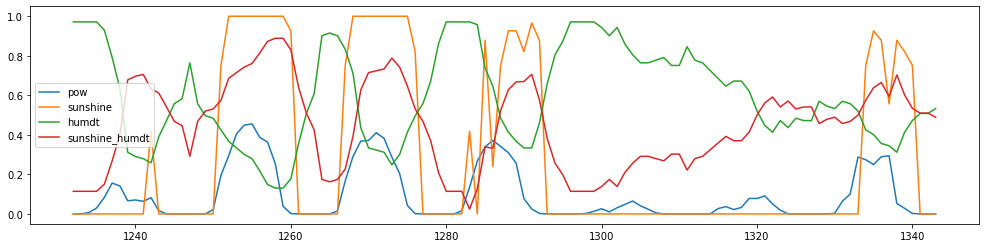

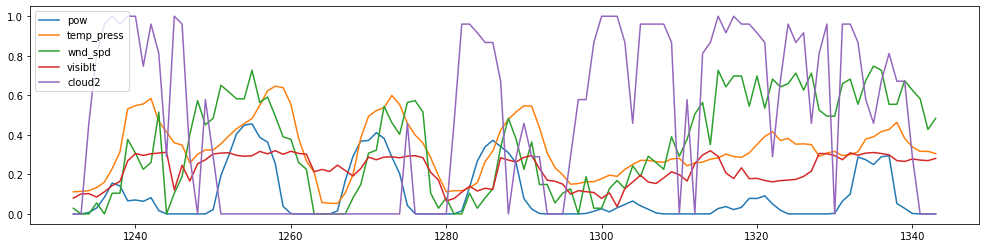

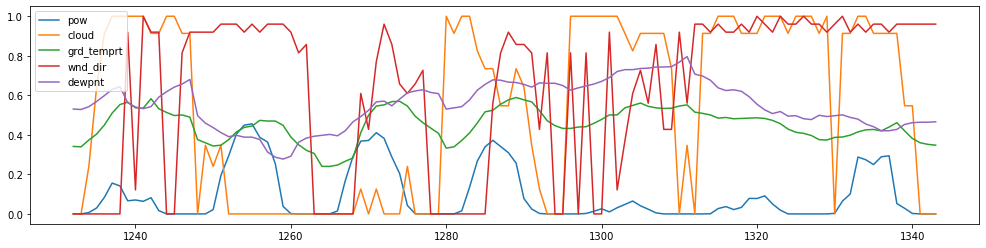

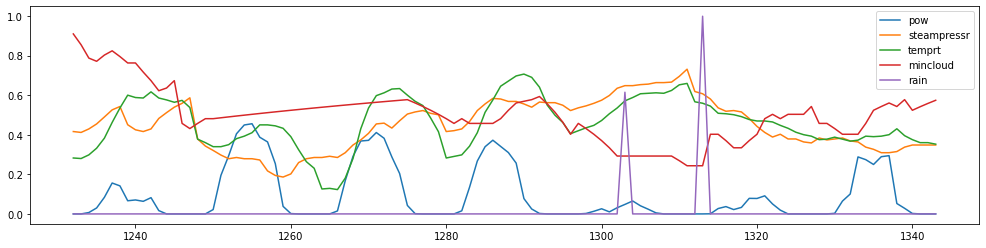

************************************************************************************************************************


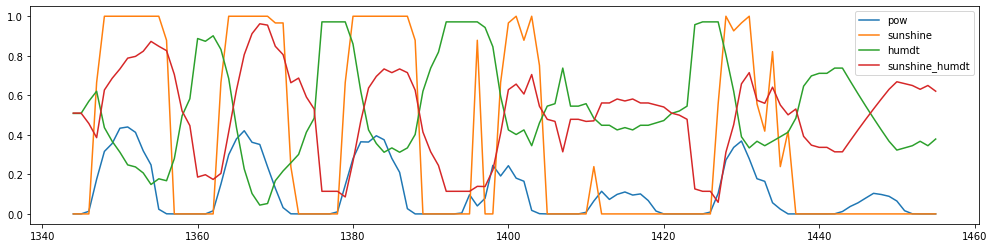

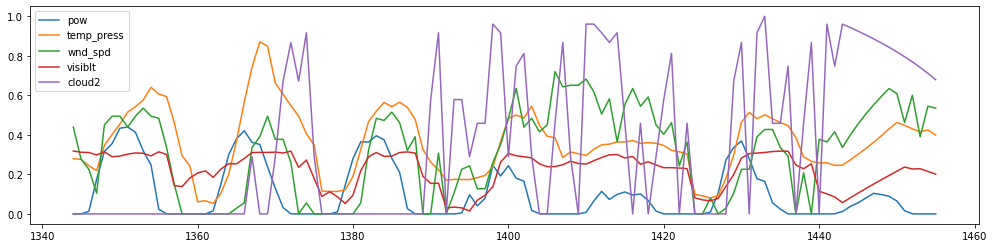

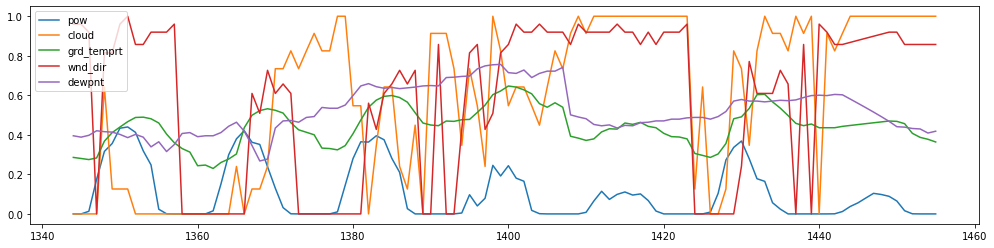

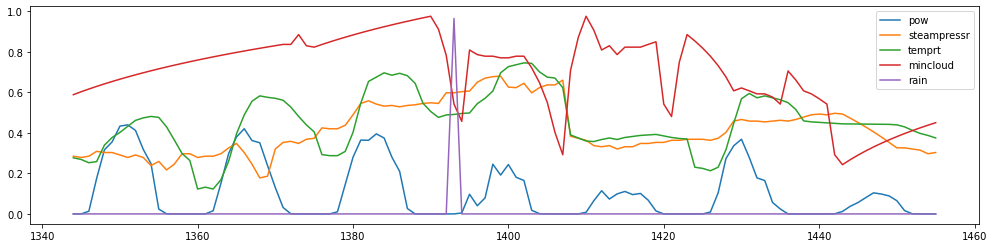

************************************************************************************************************************


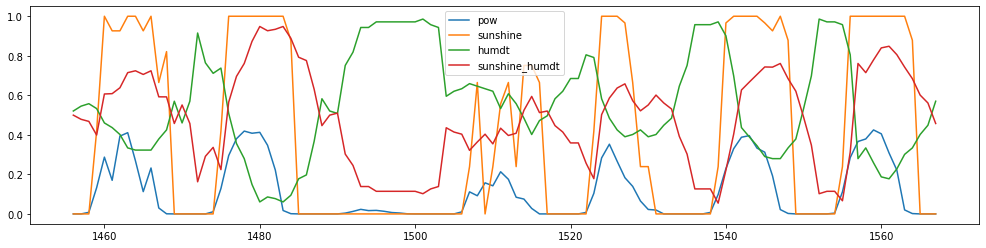

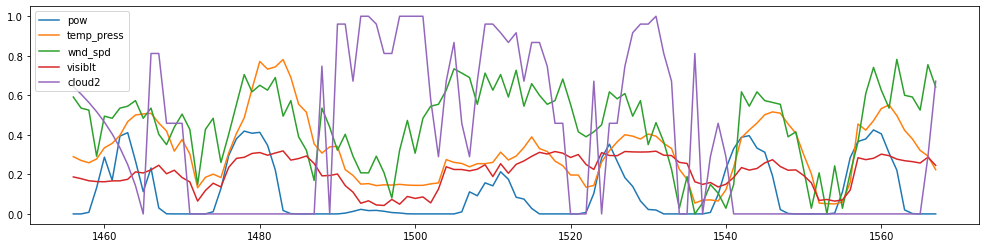

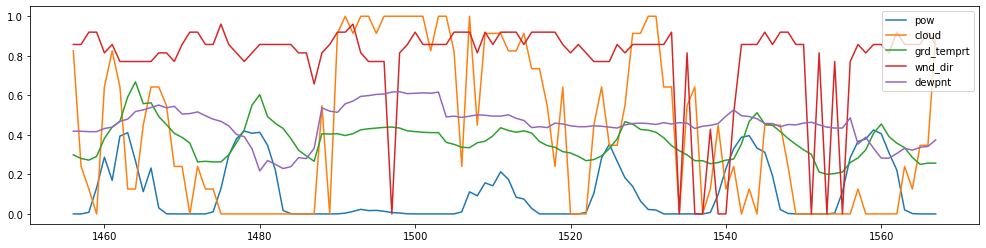

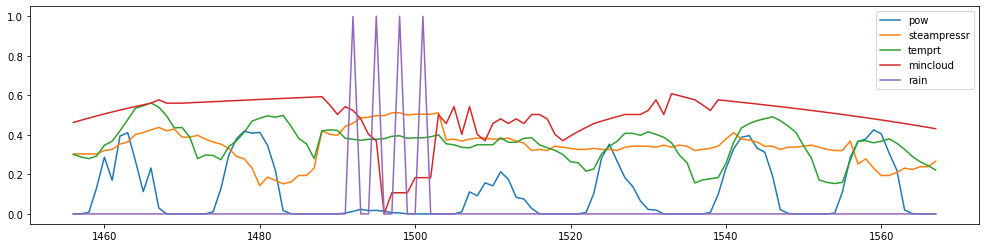

************************************************************************************************************************


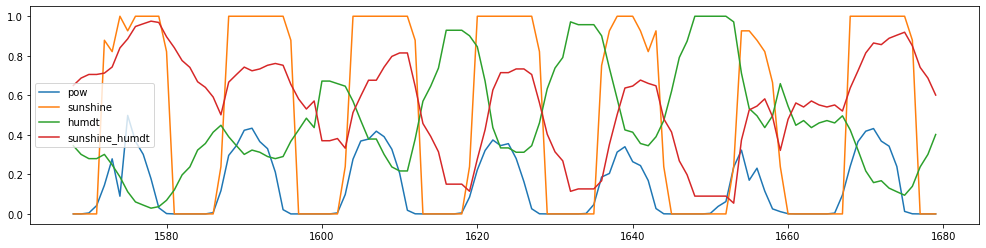

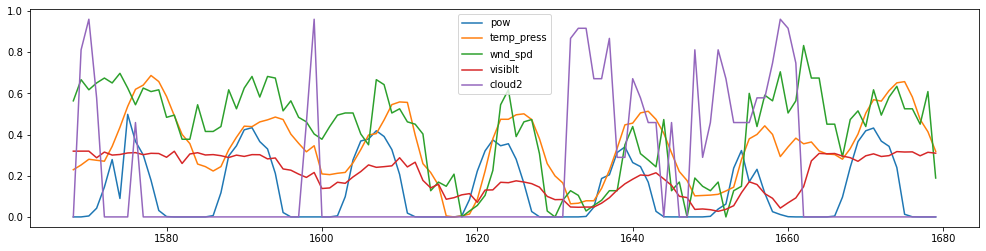

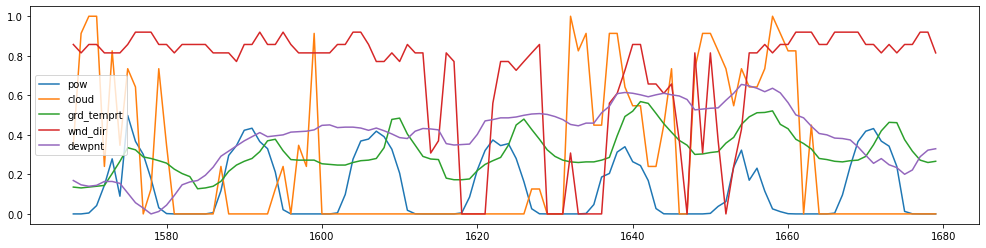

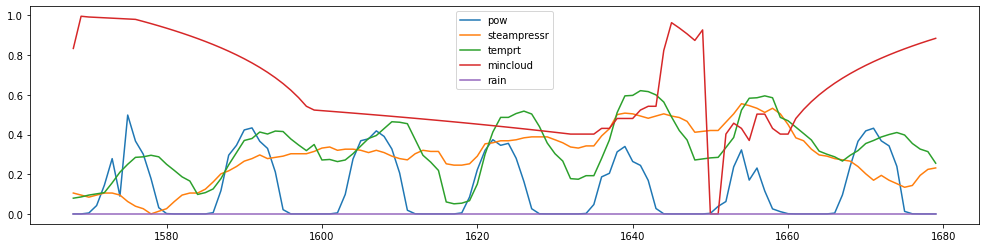

************************************************************************************************************************


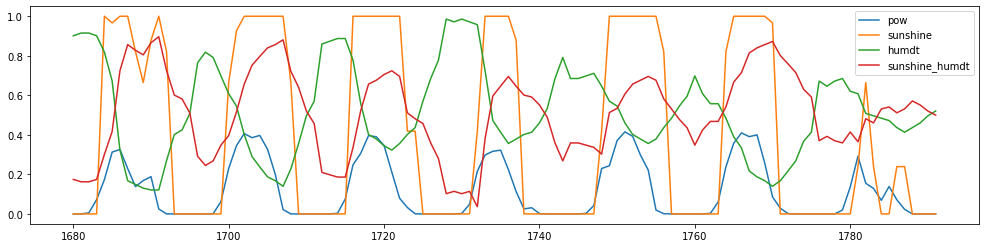

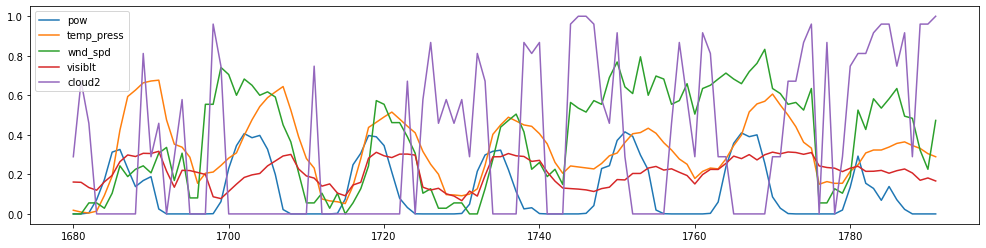

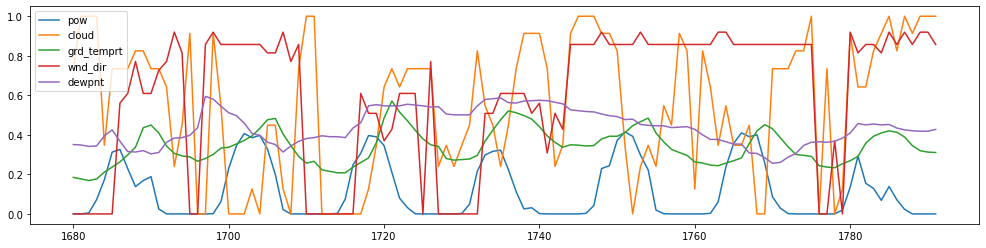

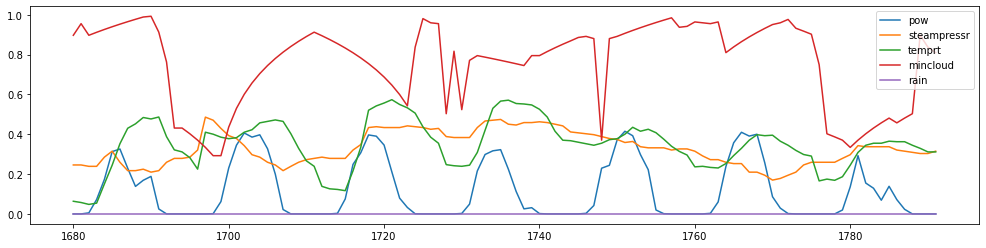

************************************************************************************************************************


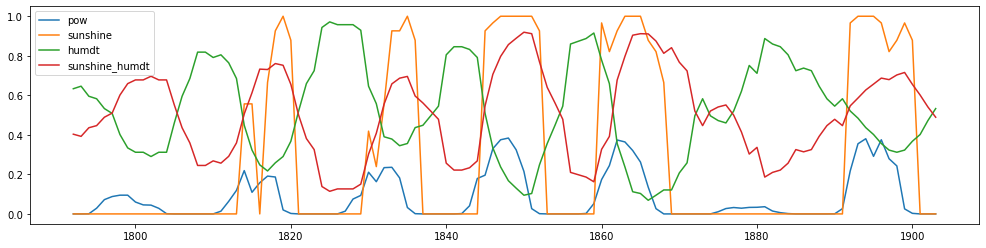

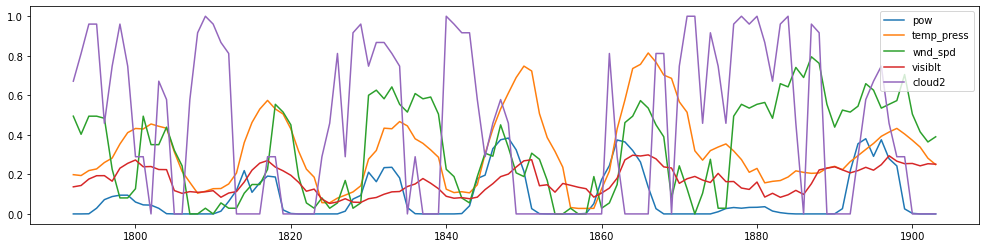

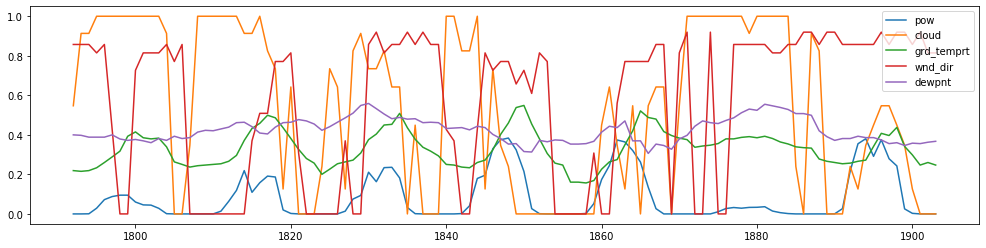

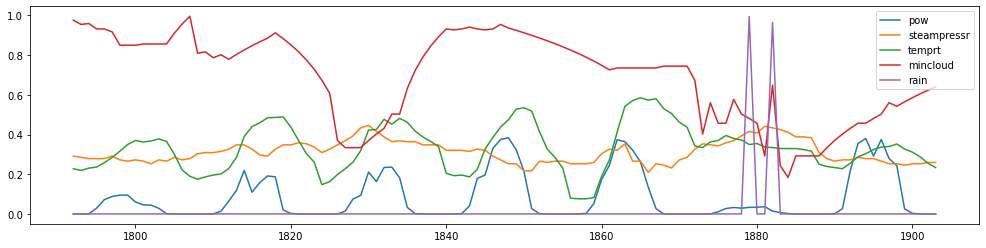

************************************************************************************************************************


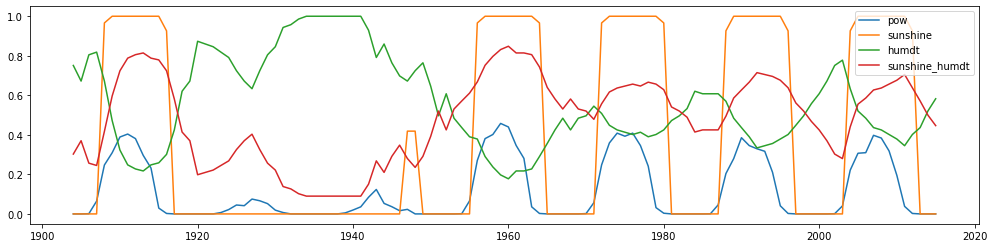

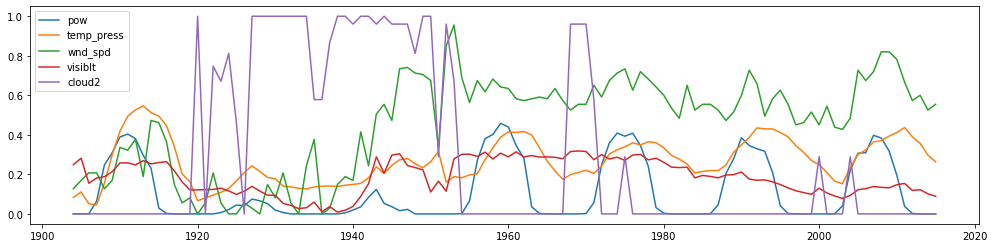

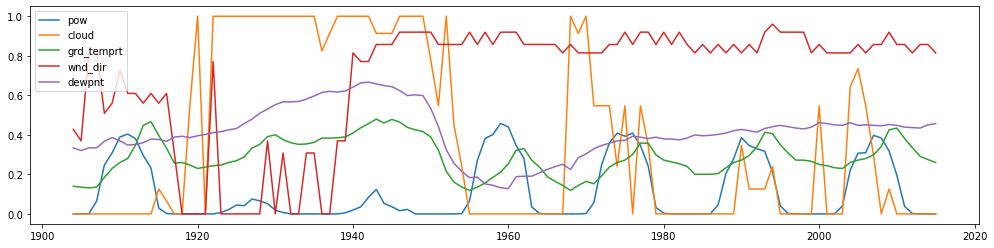

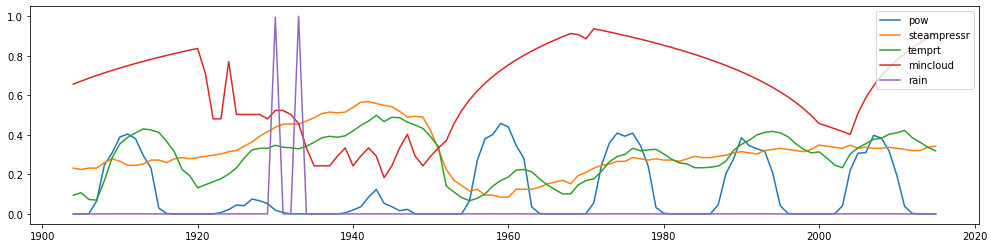

************************************************************************************************************************


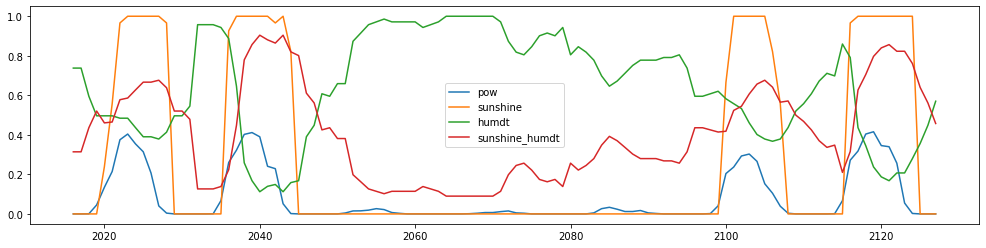

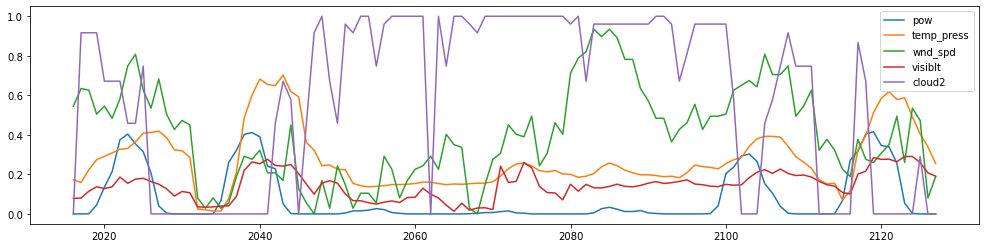

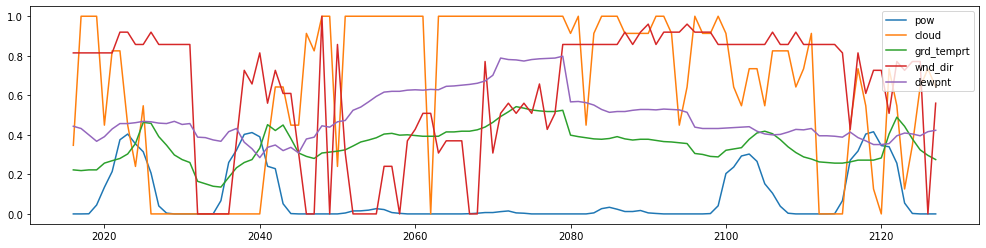

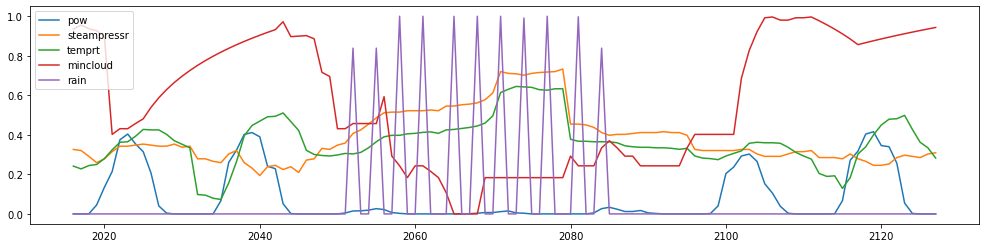

************************************************************************************************************************


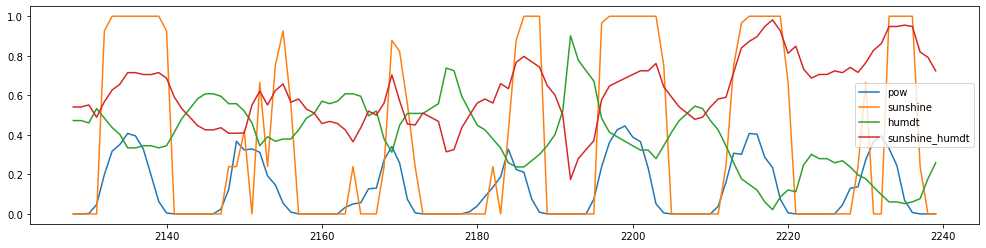

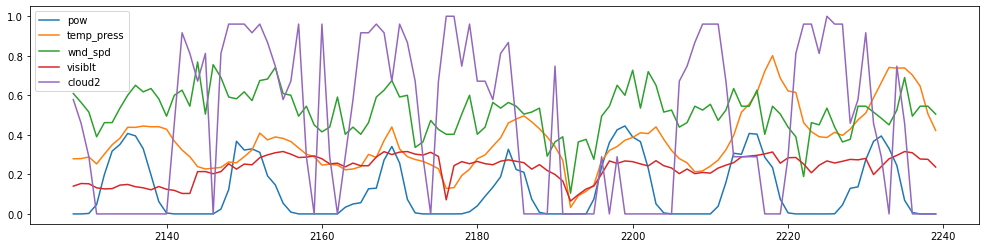

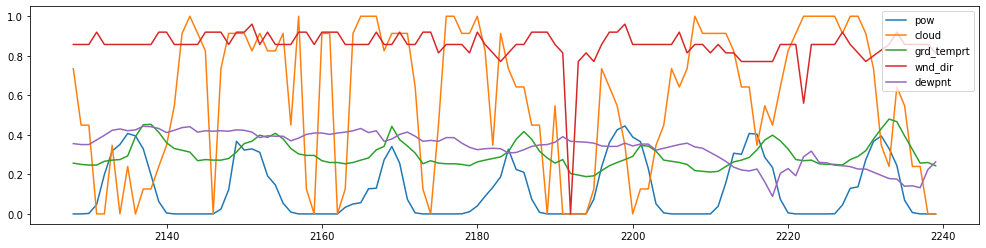

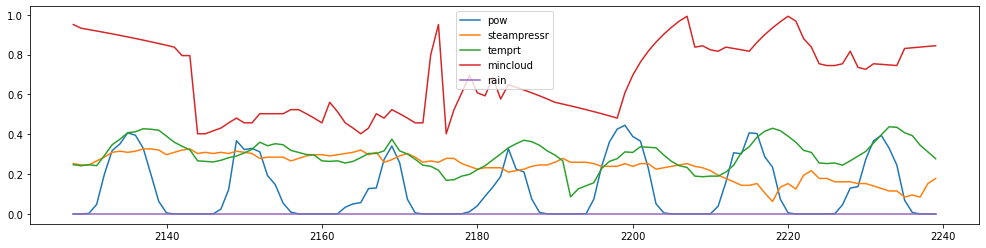

************************************************************************************************************************


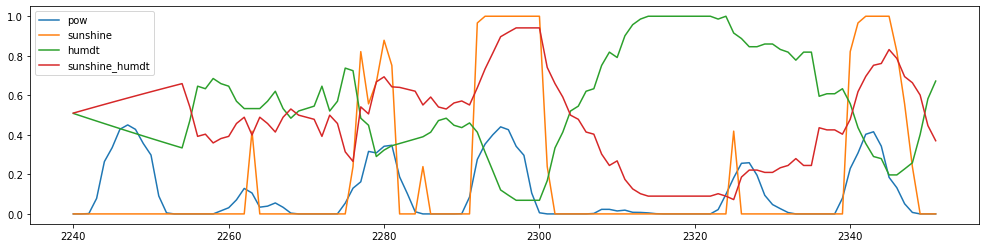

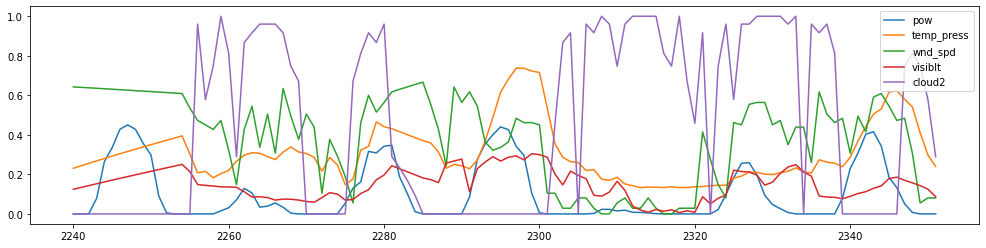

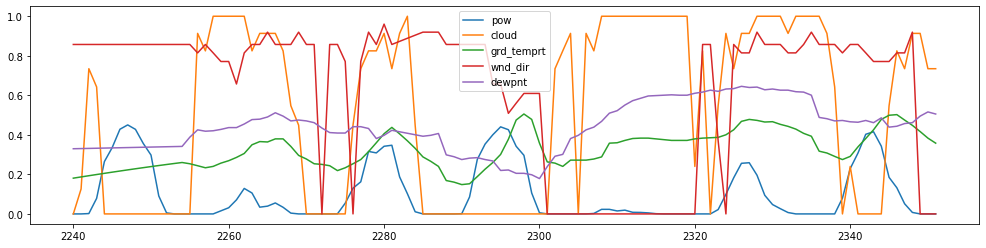

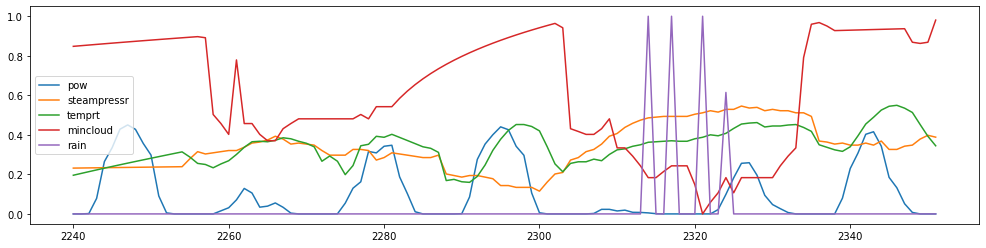

************************************************************************************************************************


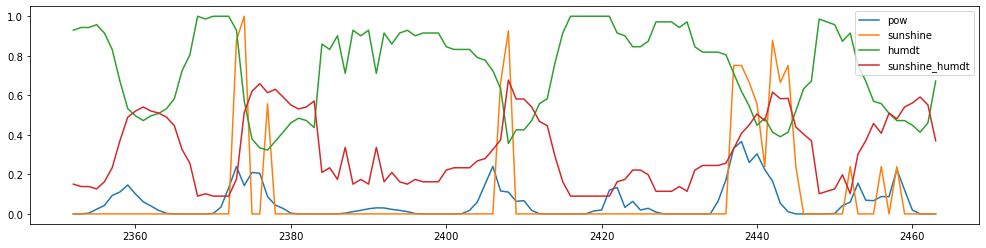

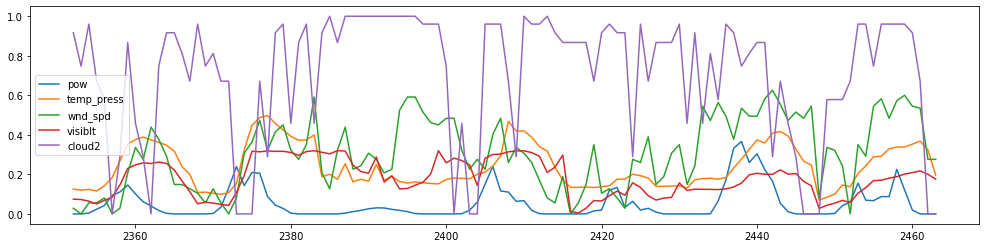

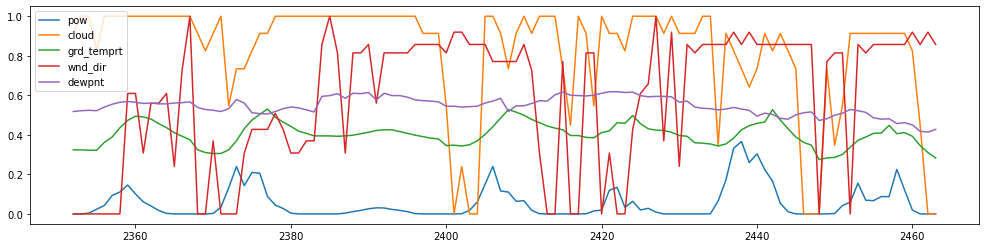

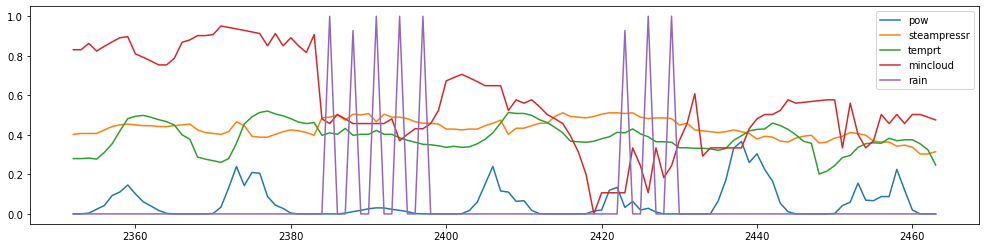

************************************************************************************************************************


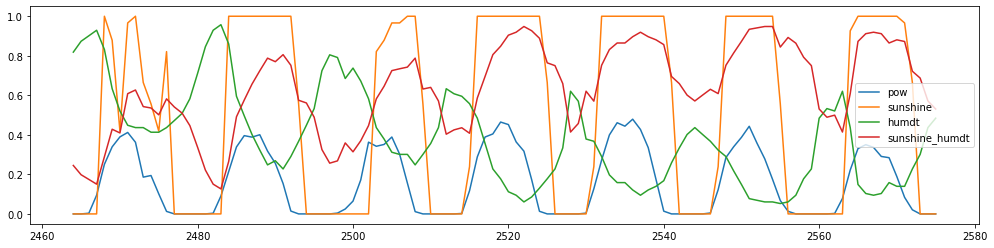

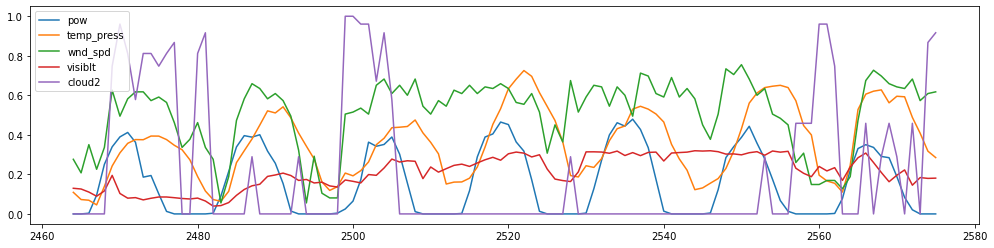

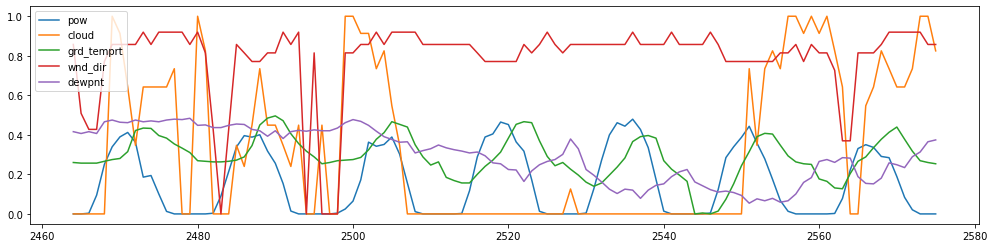

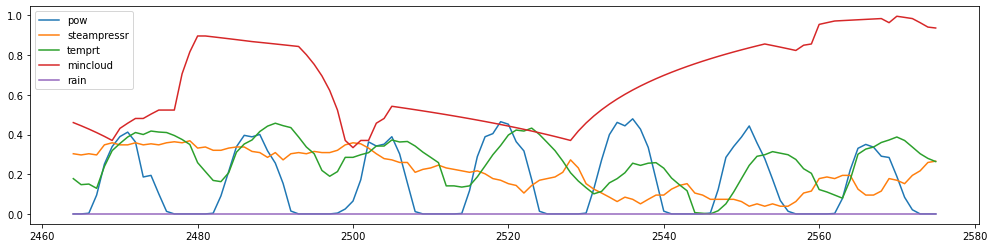

************************************************************************************************************************


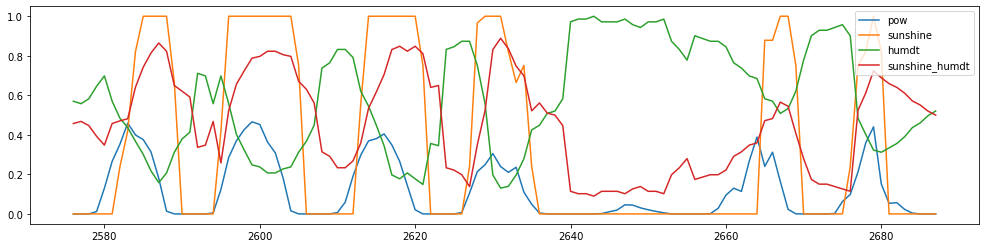

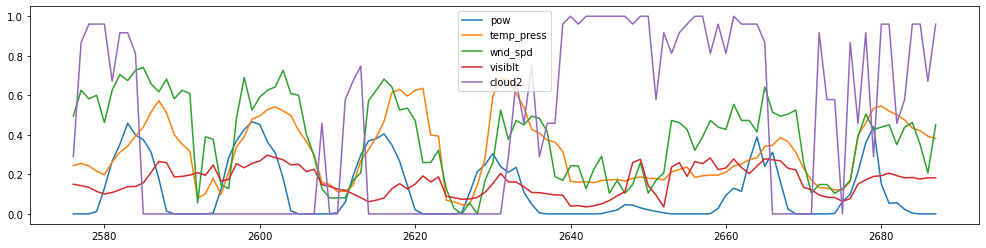

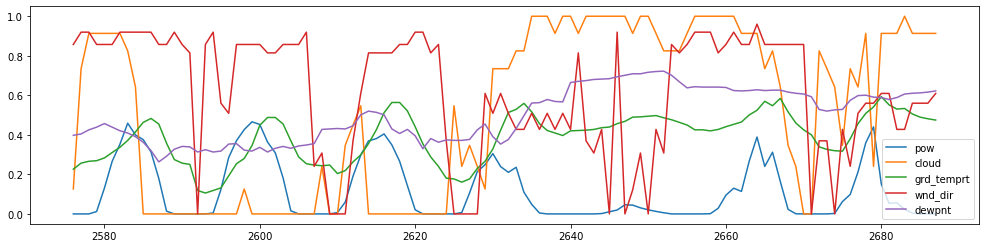

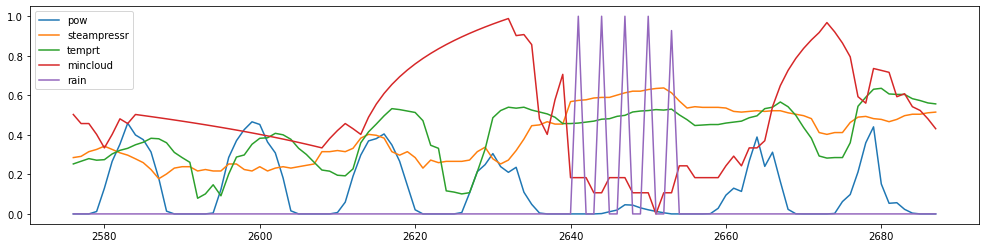

************************************************************************************************************************


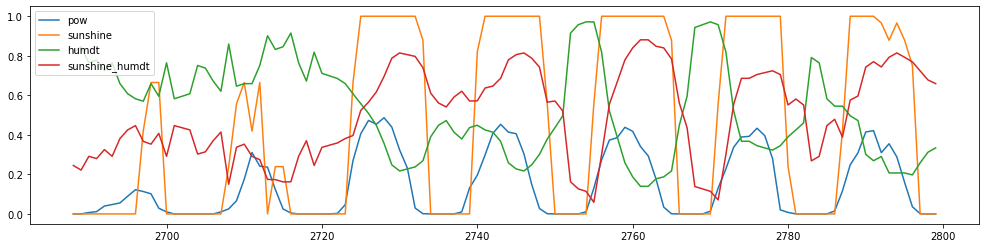

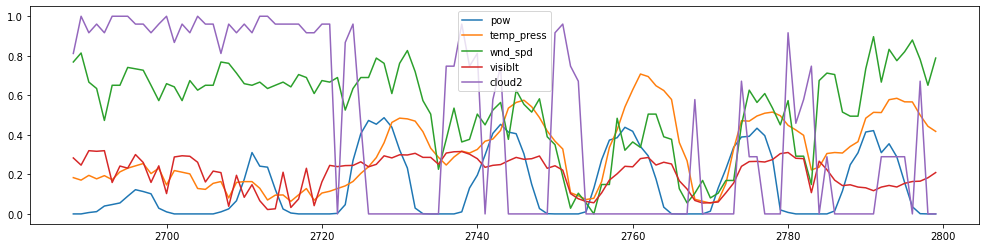

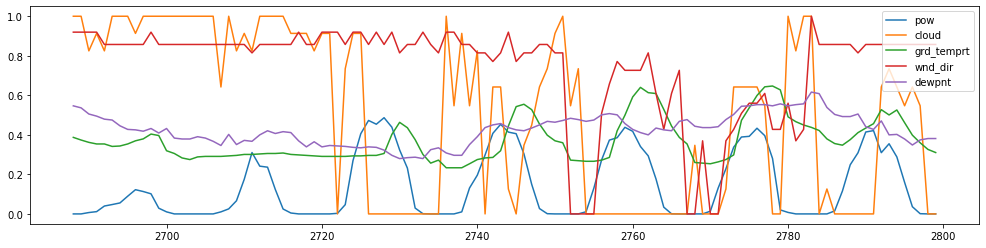

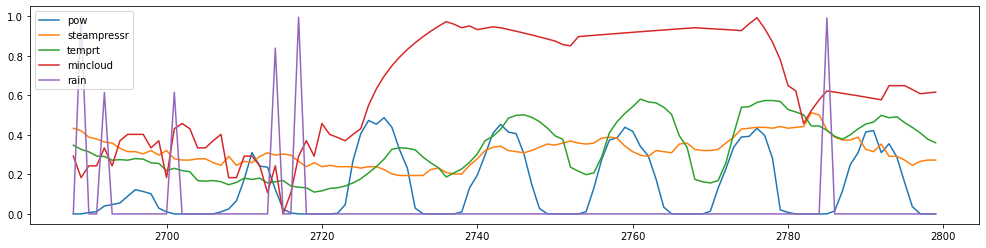

************************************************************************************************************************


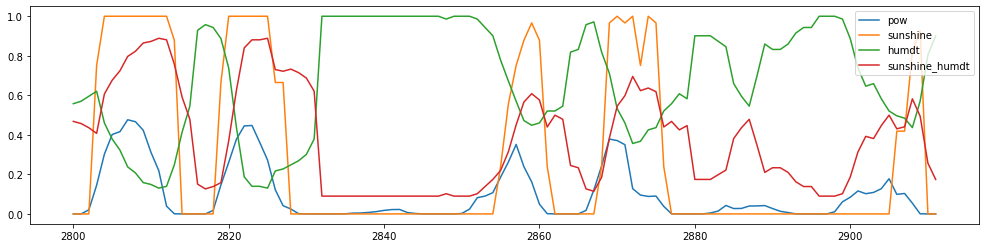

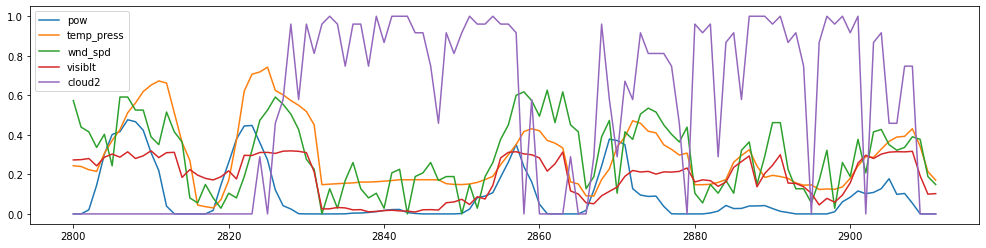

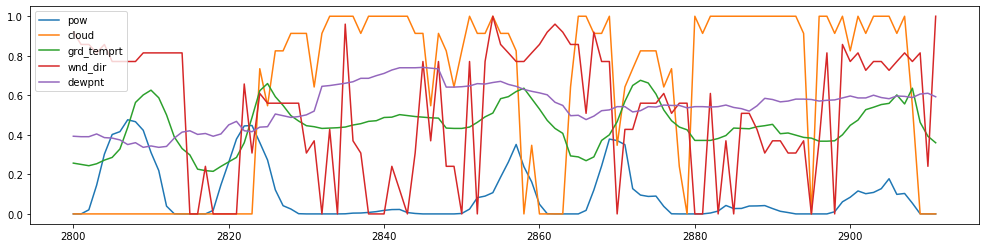

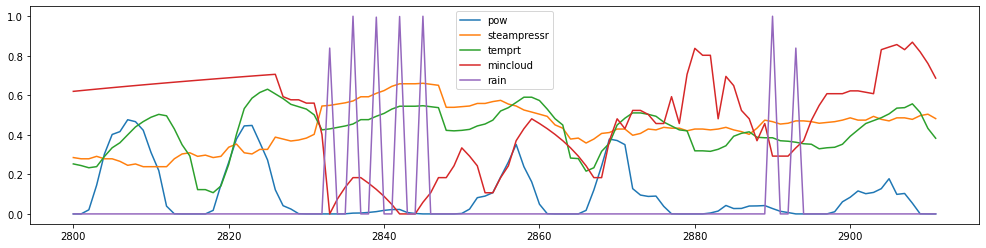

************************************************************************************************************************


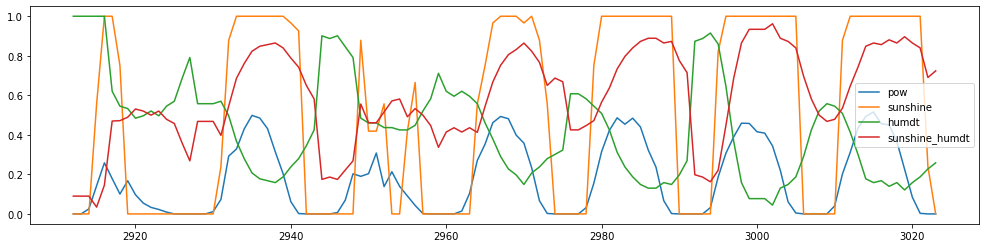

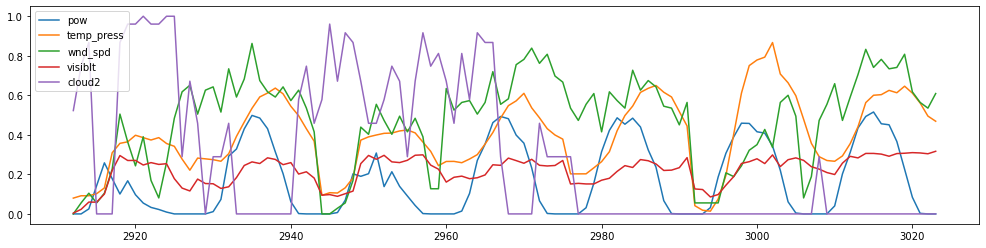

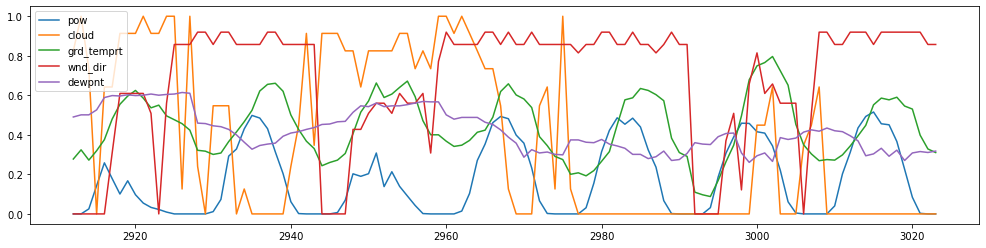

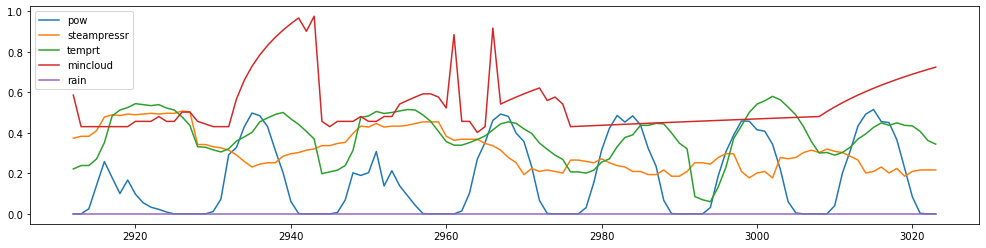

************************************************************************************************************************


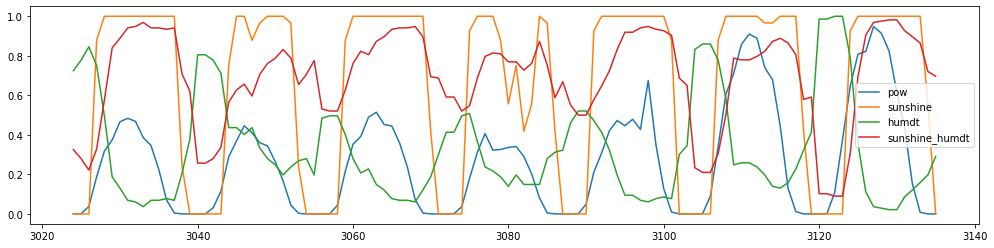

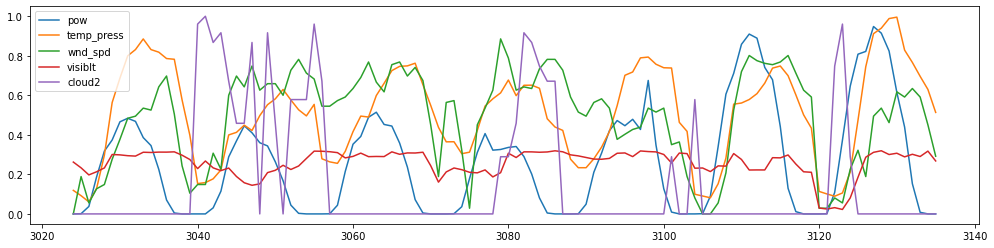

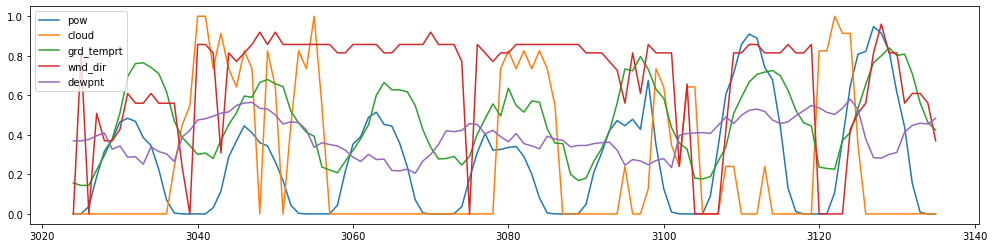

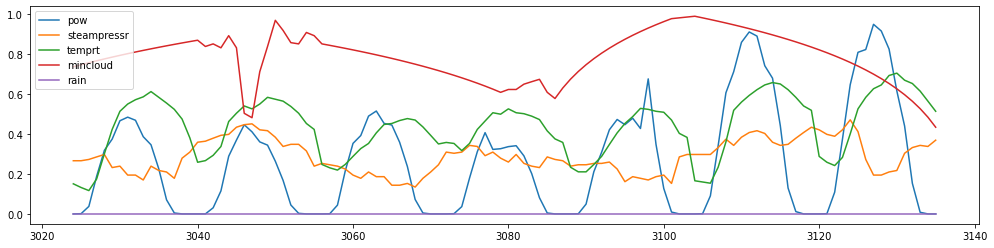

************************************************************************************************************************


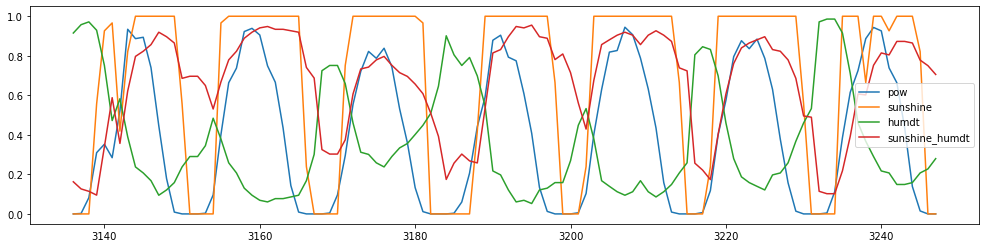

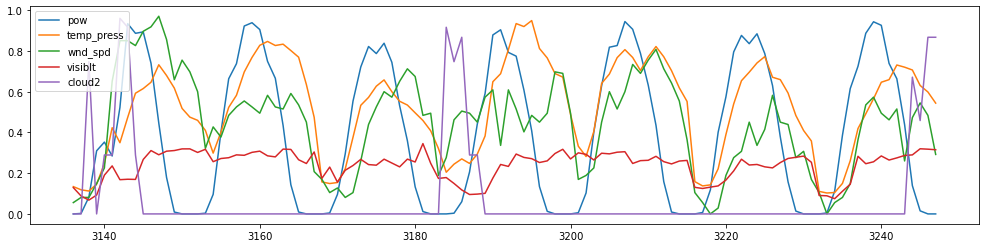

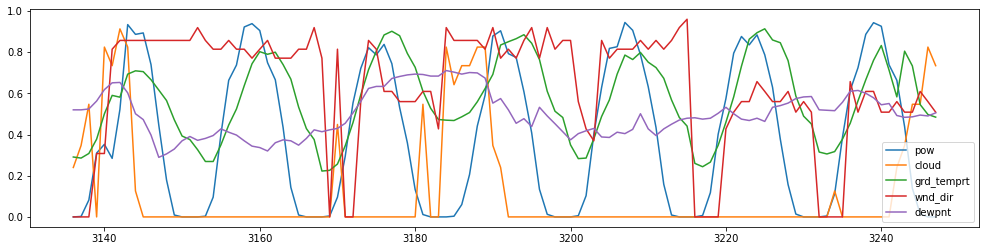

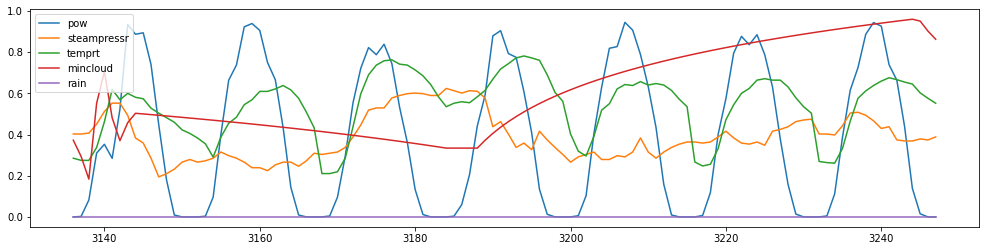

************************************************************************************************************************


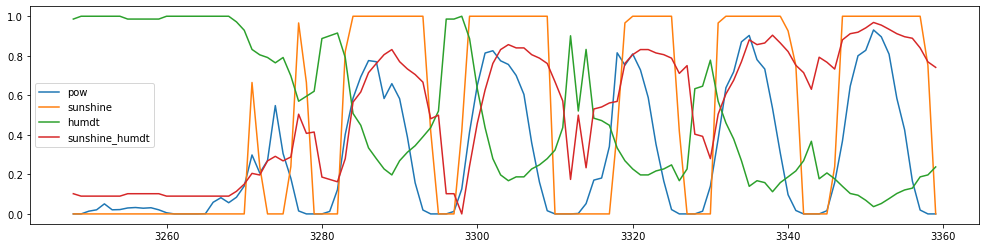

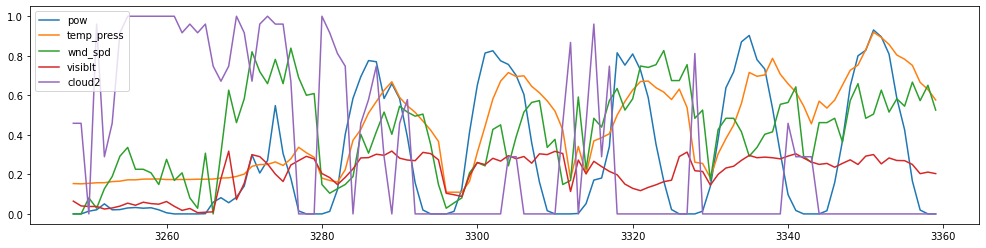

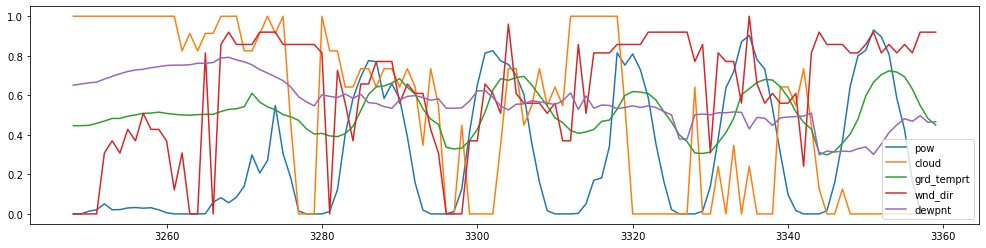

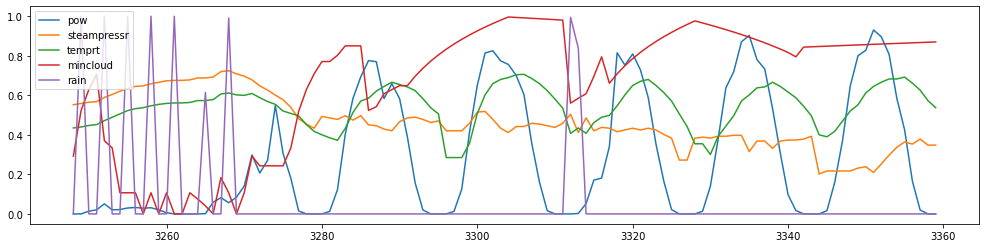

************************************************************************************************************************


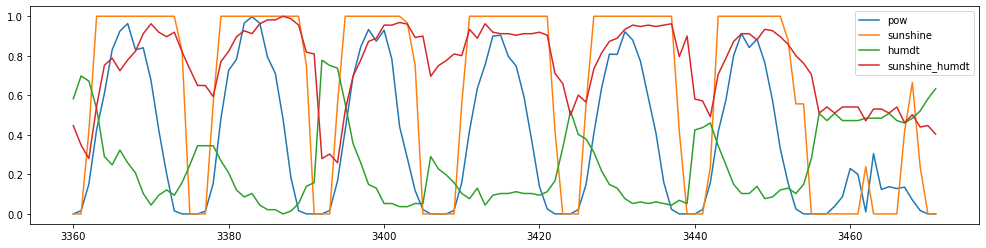

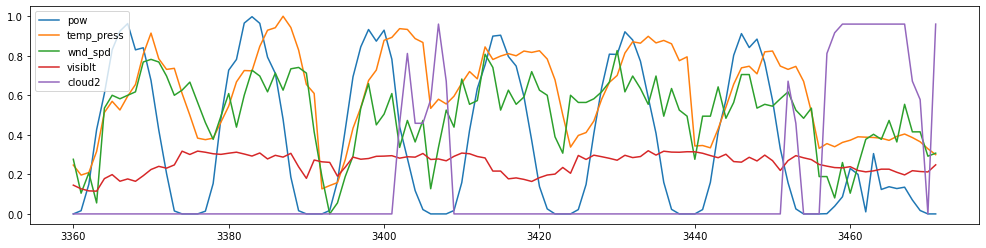

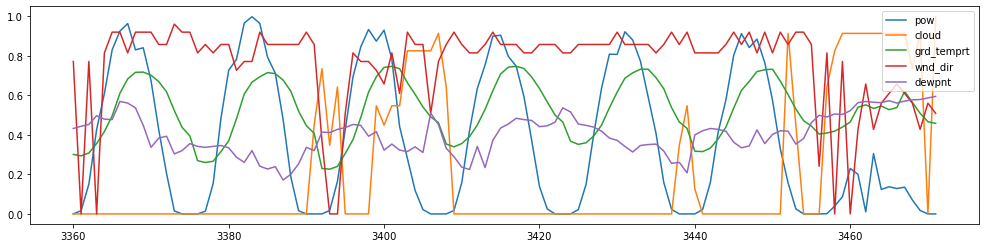

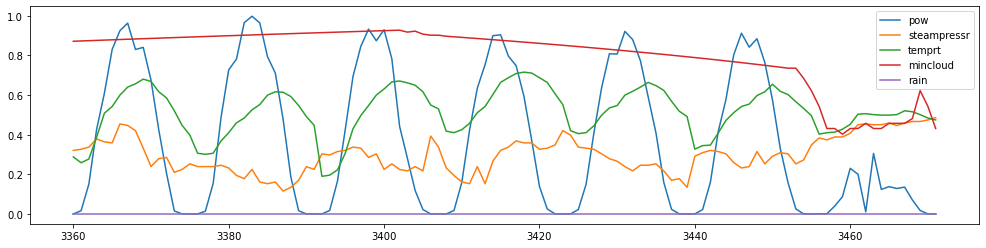

************************************************************************************************************************


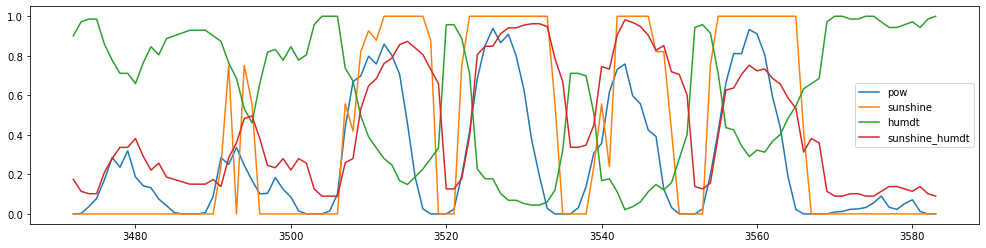

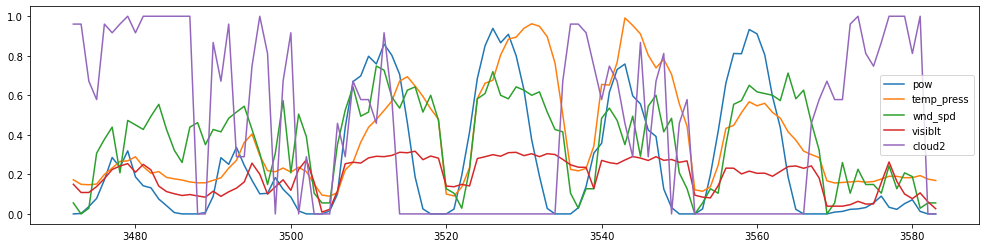

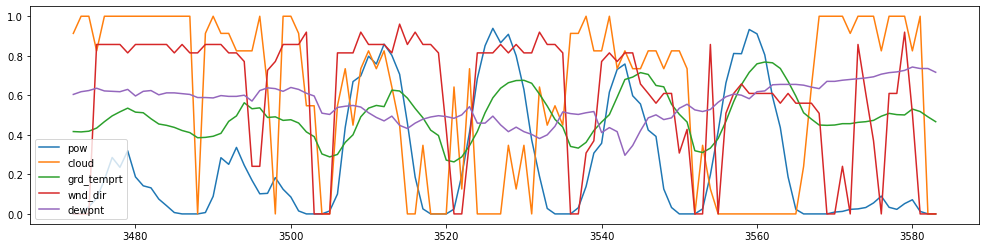

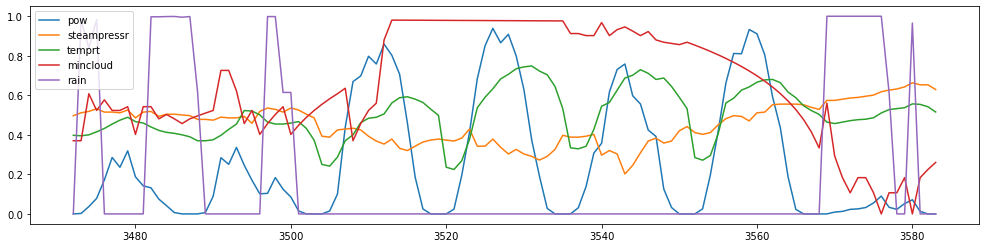

************************************************************************************************************************


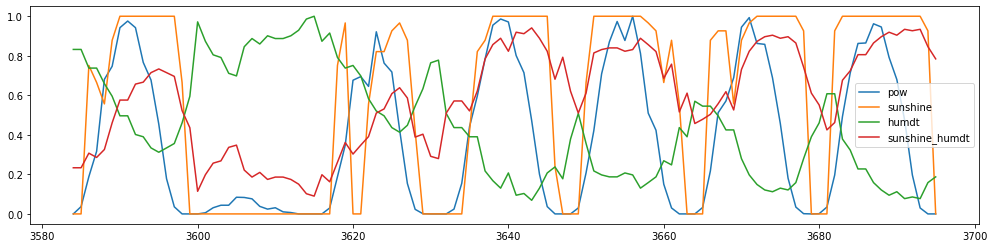

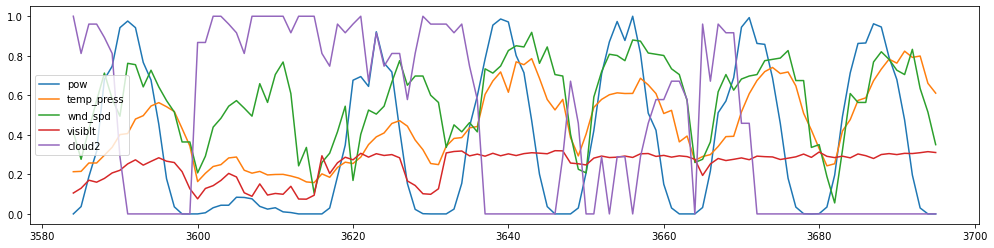

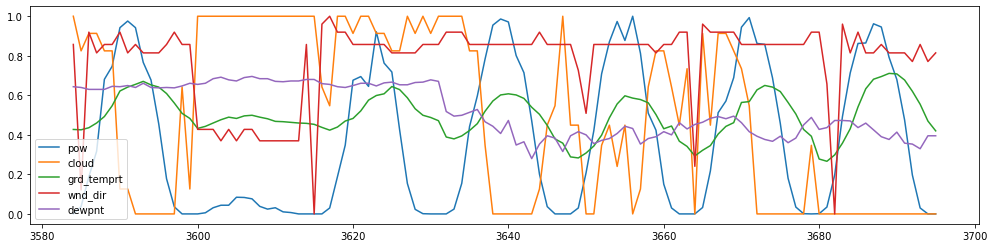

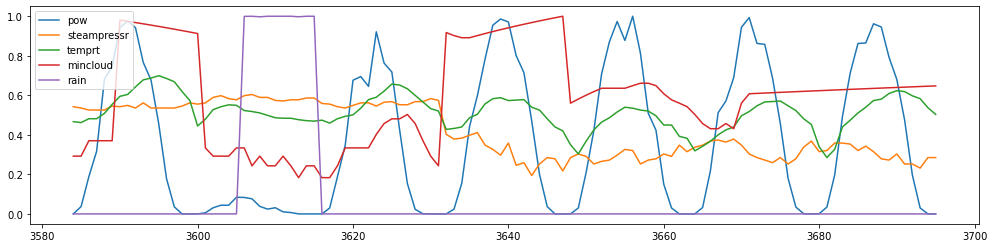

************************************************************************************************************************


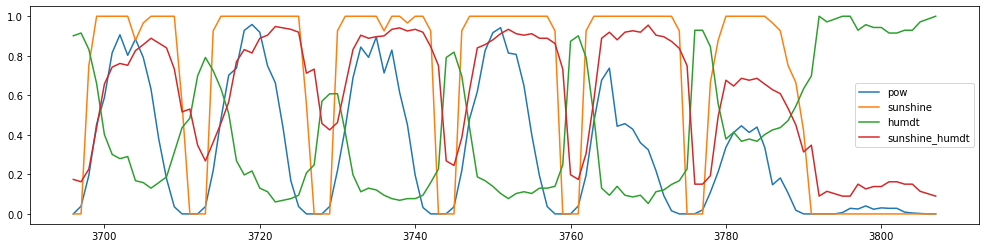

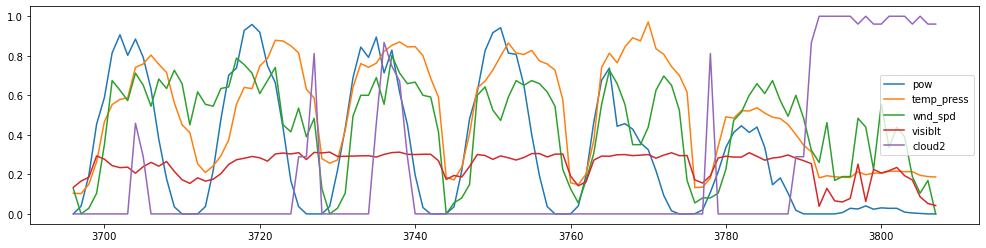

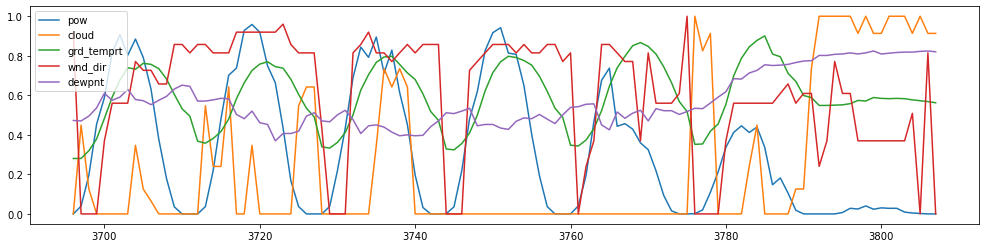

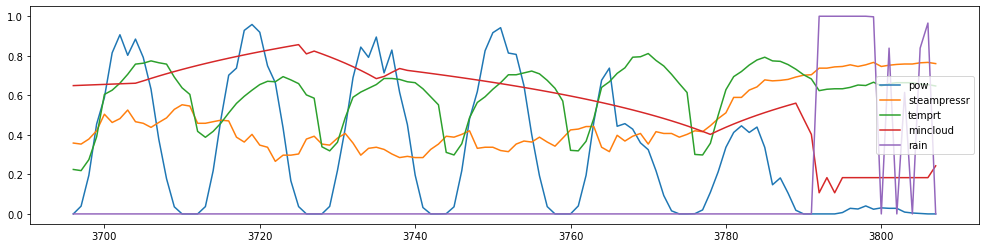

************************************************************************************************************************


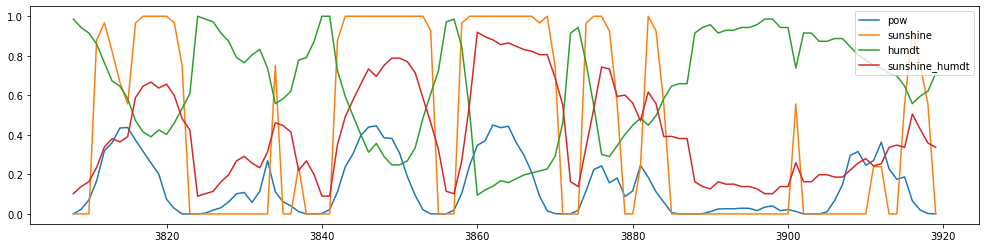

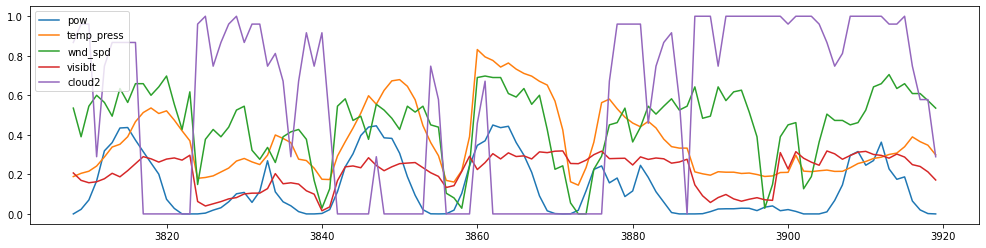

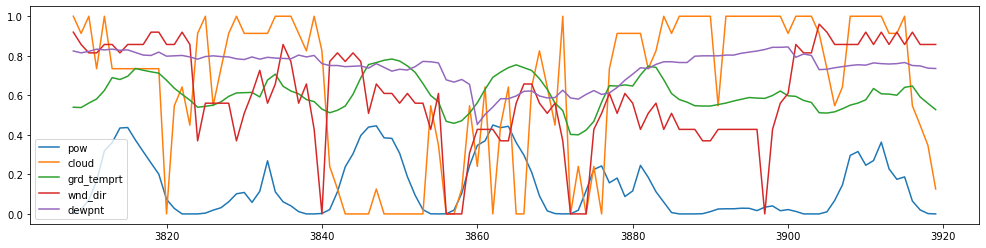

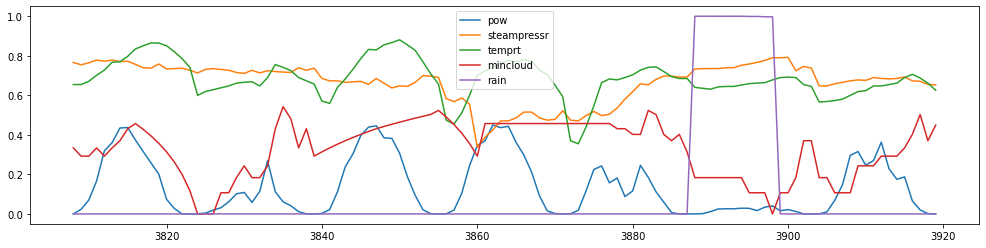

************************************************************************************************************************


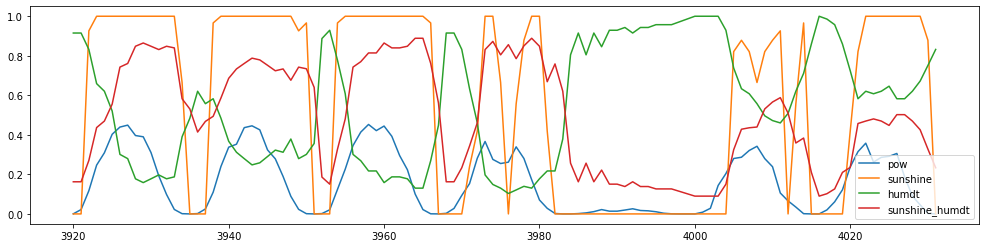

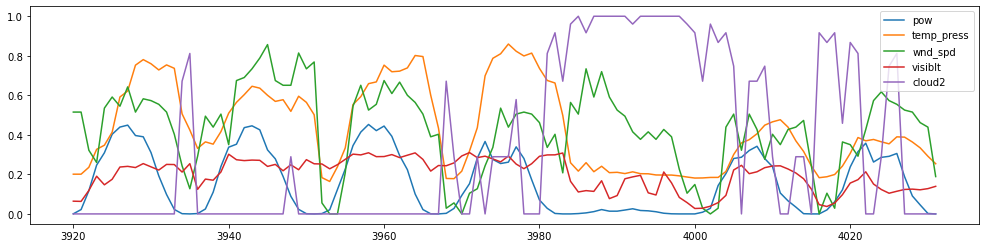

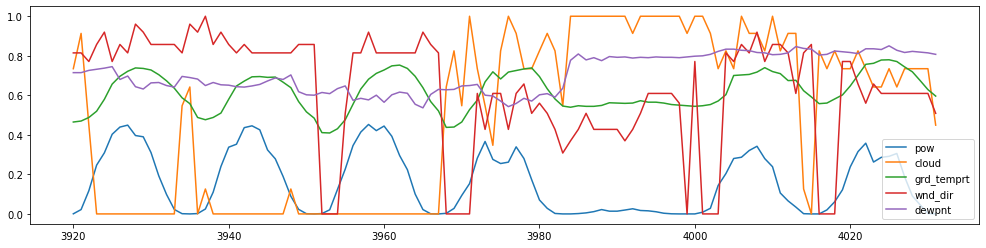

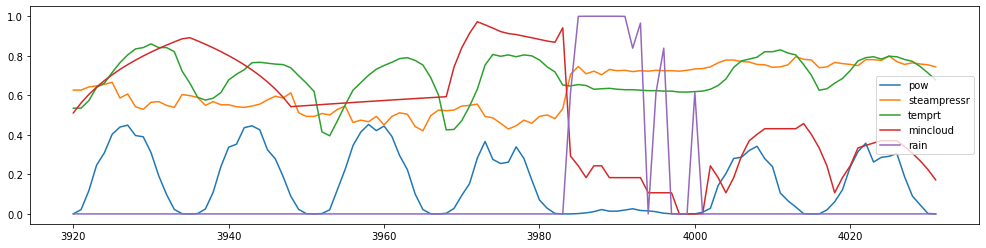

************************************************************************************************************************


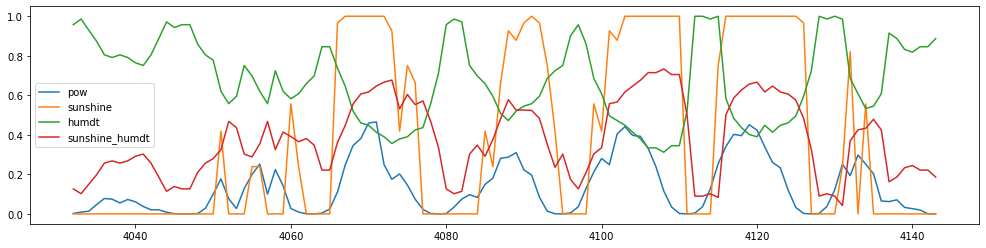

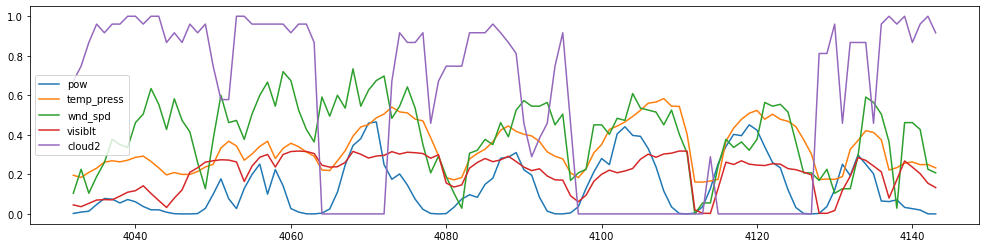

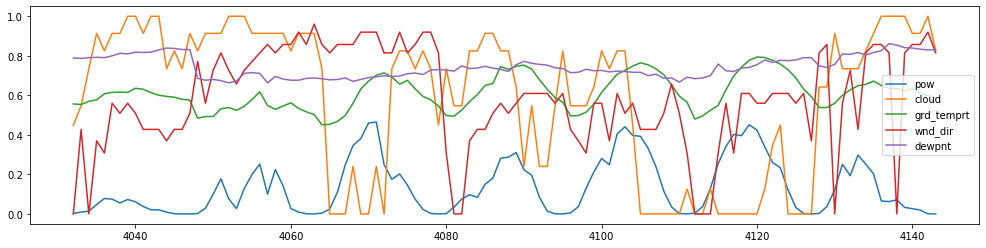

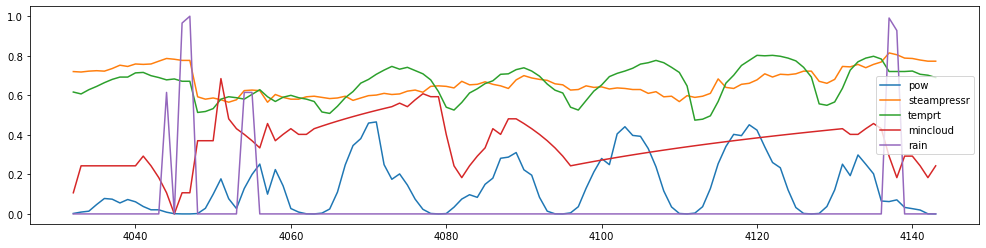

************************************************************************************************************************


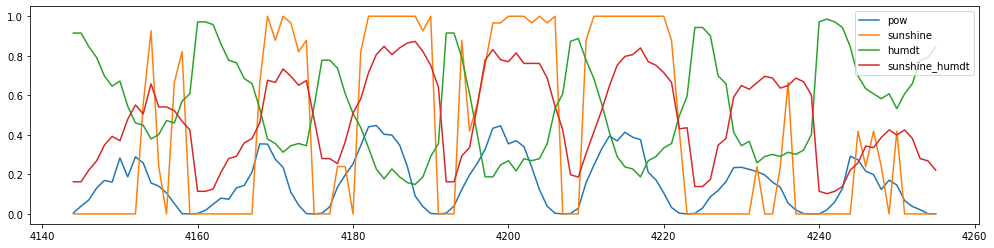

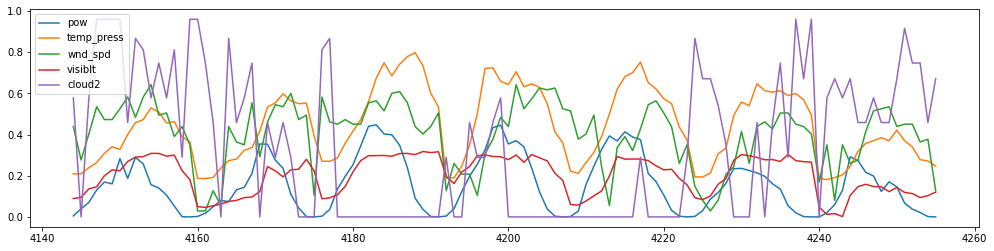

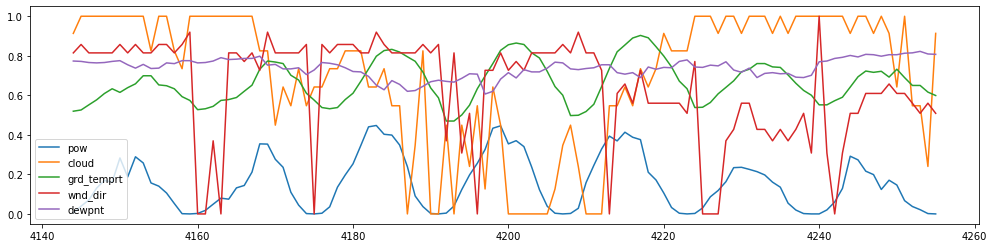

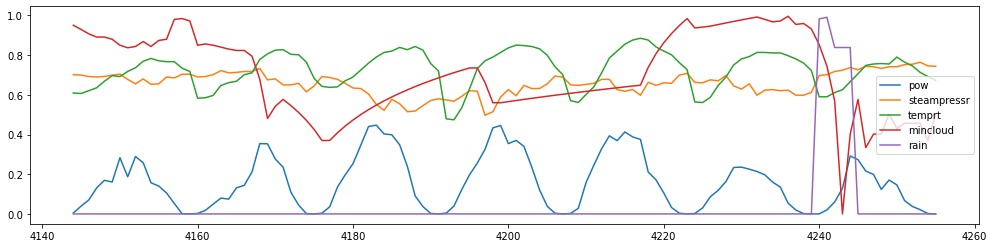

************************************************************************************************************************


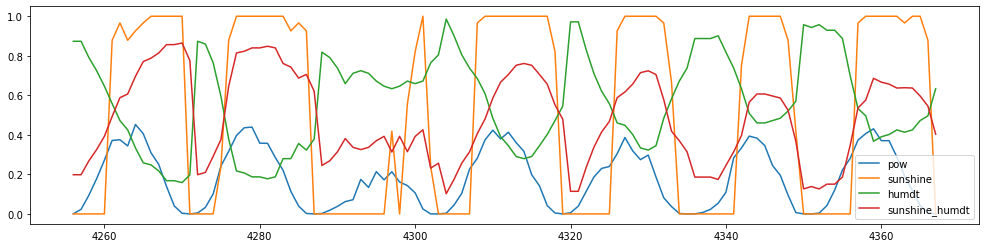

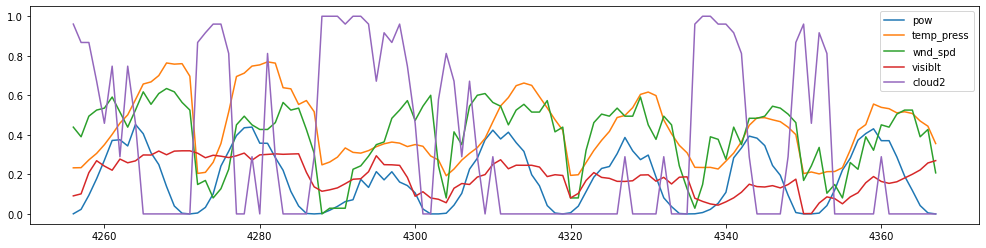

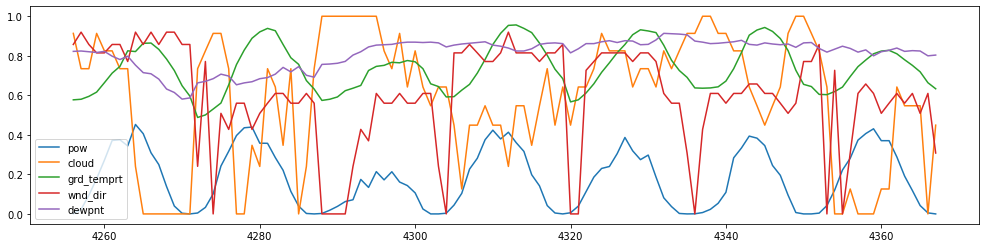

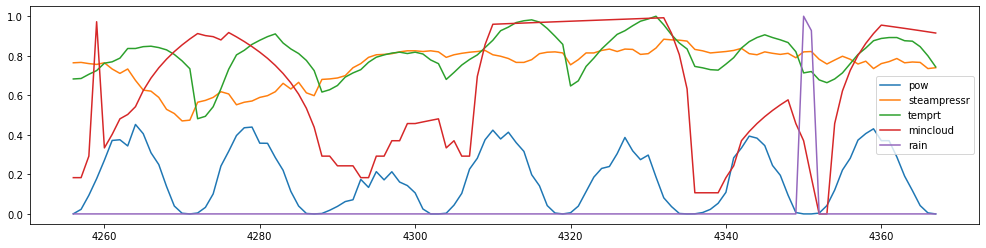

************************************************************************************************************************


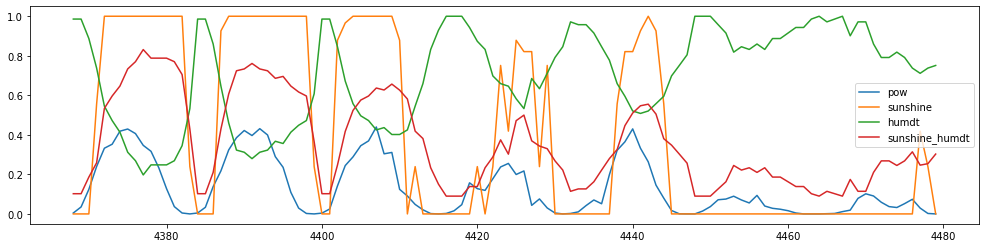

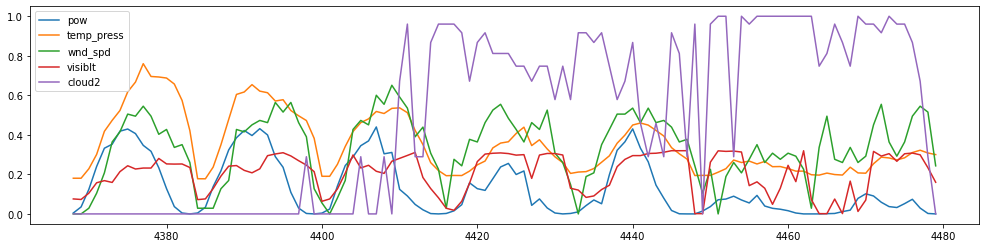

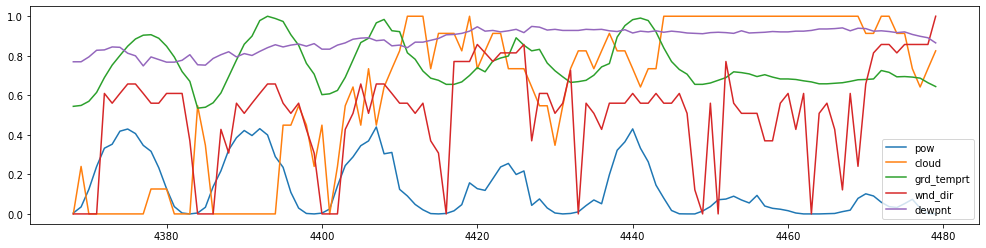

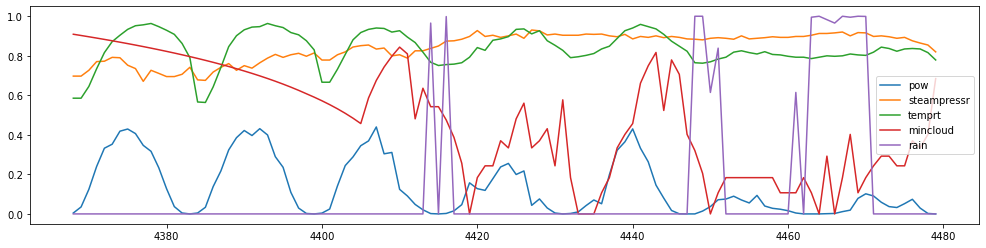

************************************************************************************************************************


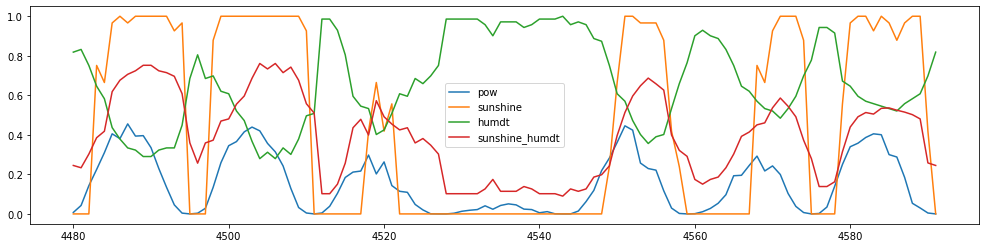

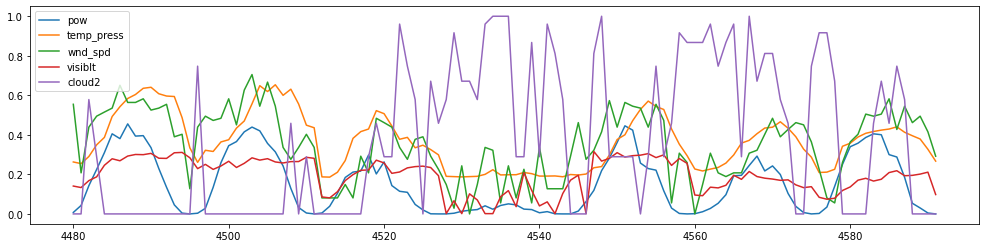

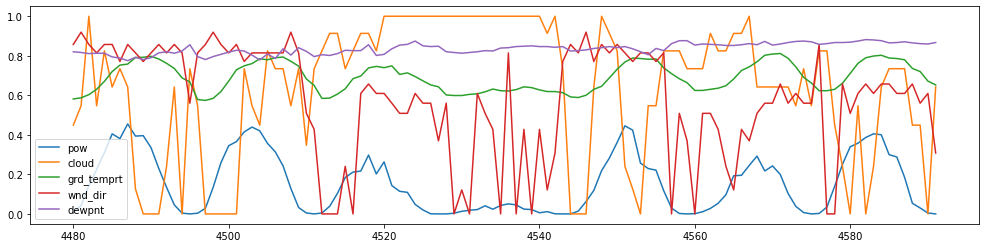

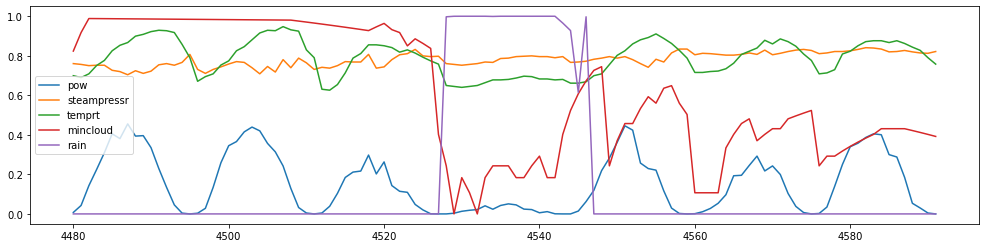

************************************************************************************************************************


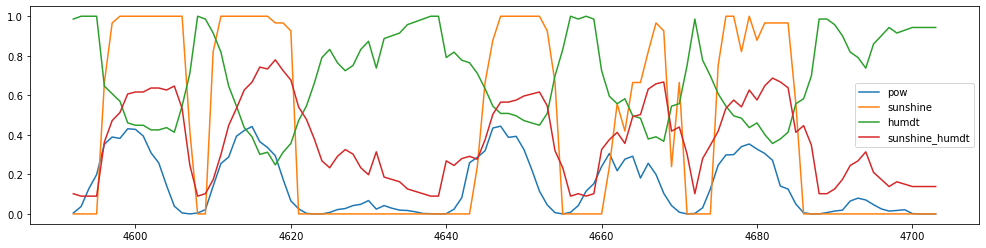

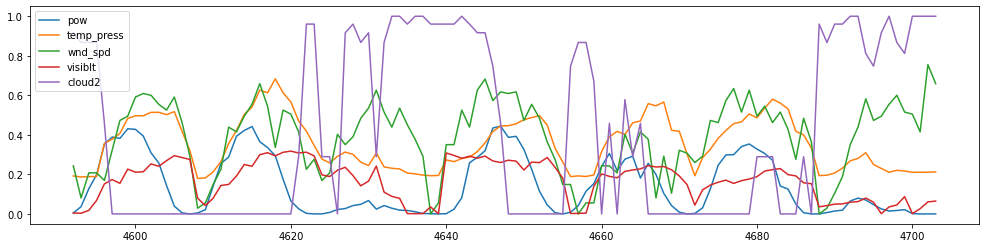

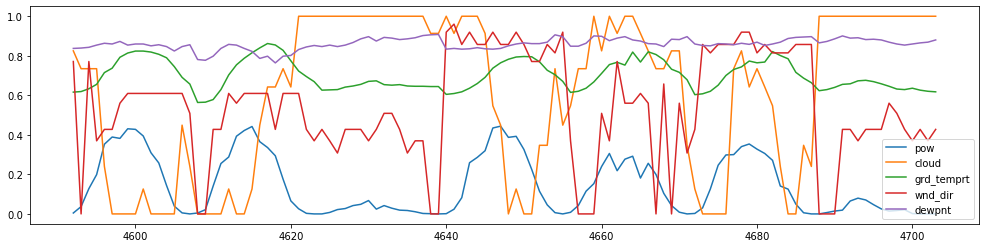

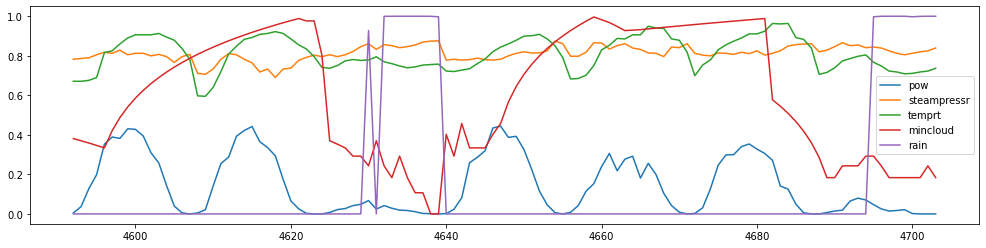

************************************************************************************************************************


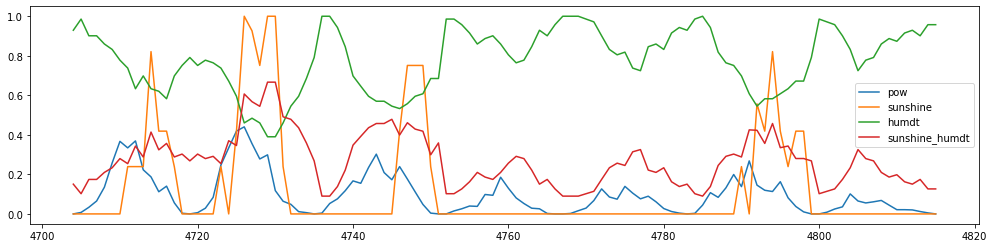

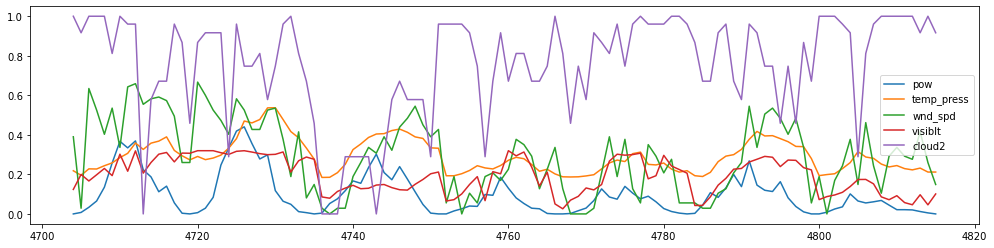

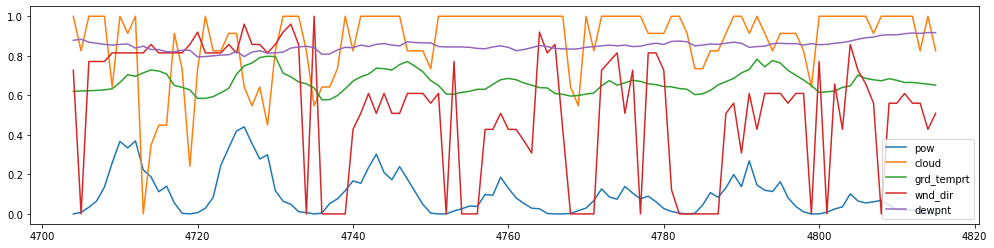

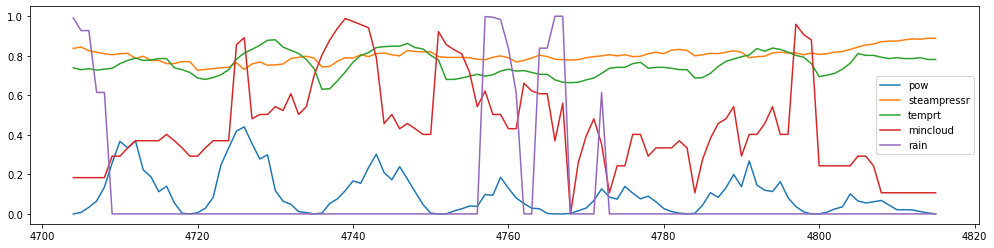

************************************************************************************************************************


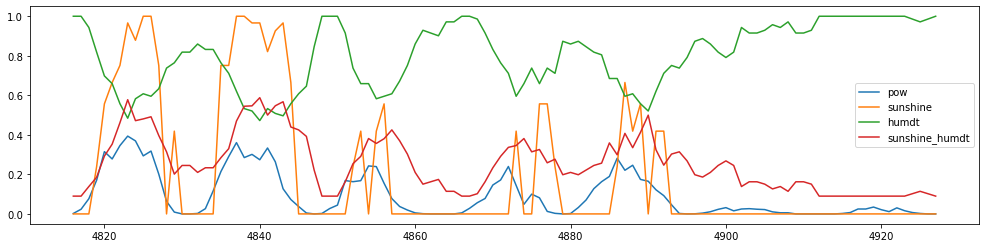

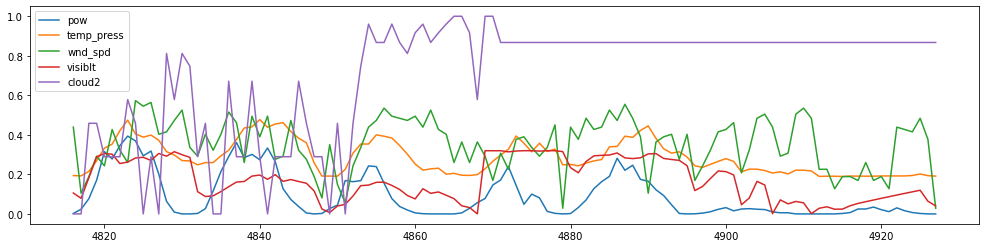

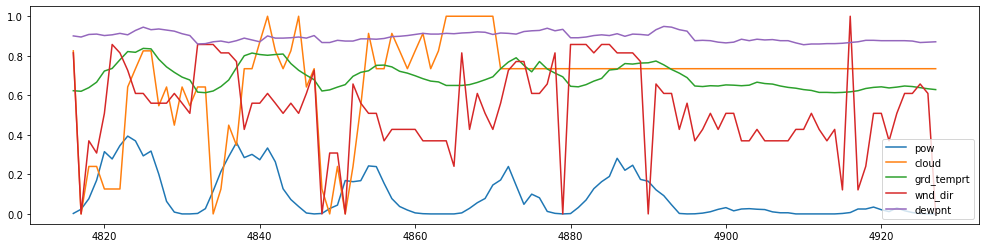

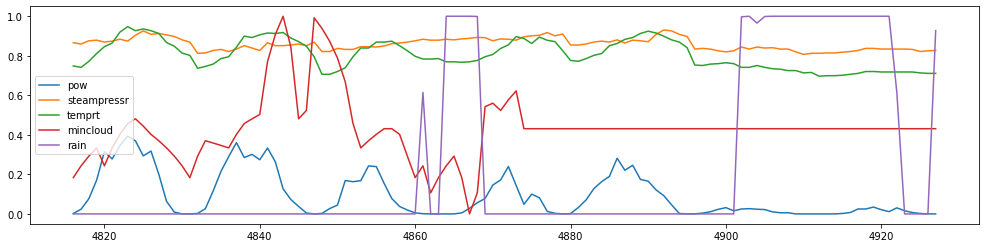

************************************************************************************************************************


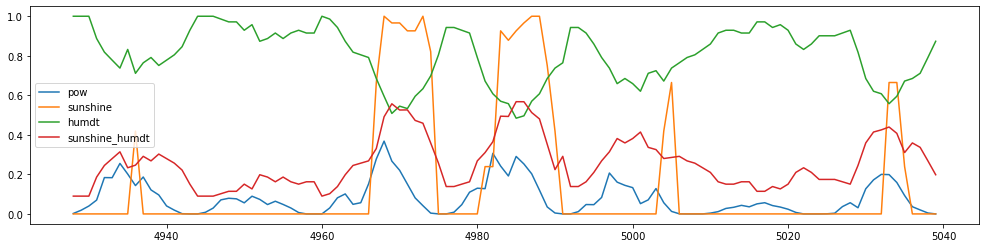

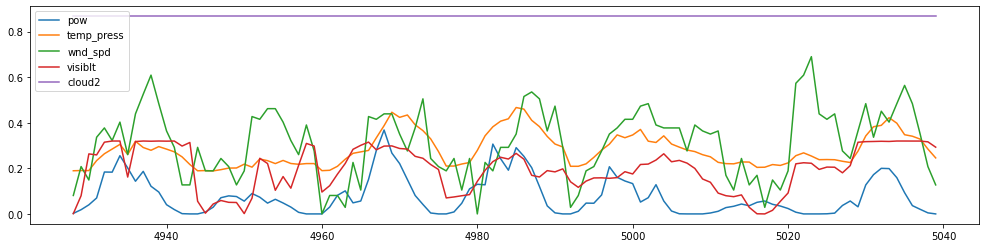

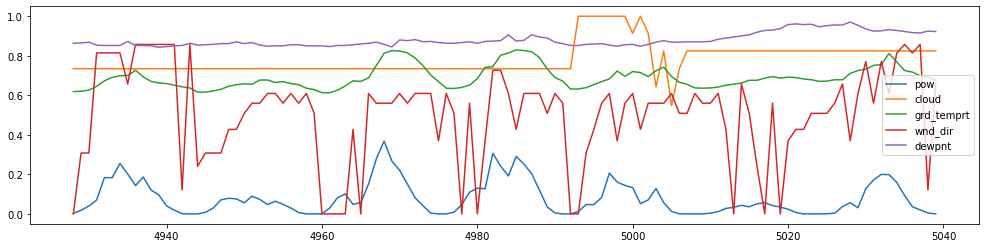

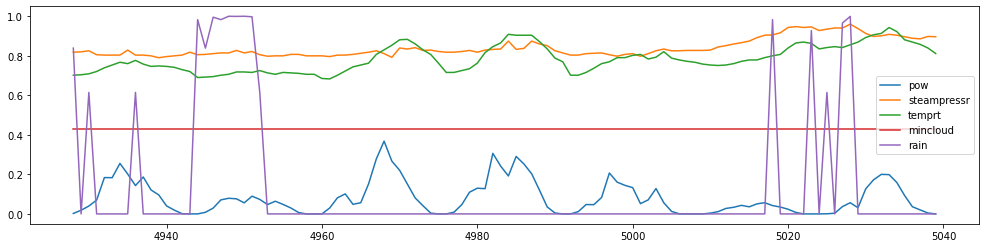

************************************************************************************************************************


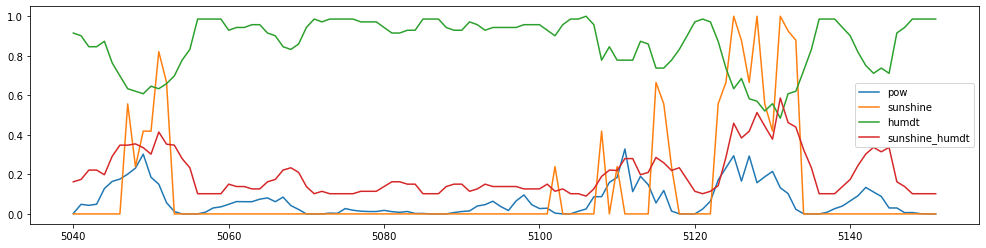

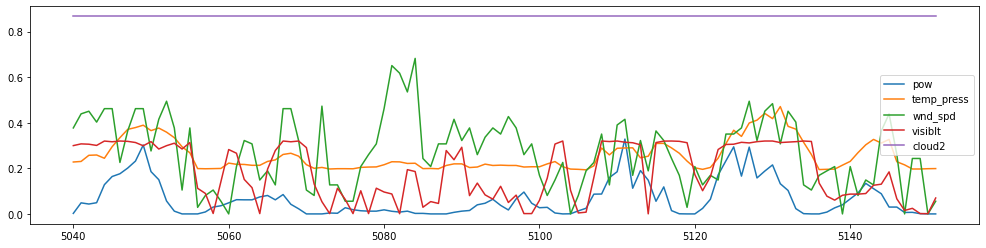

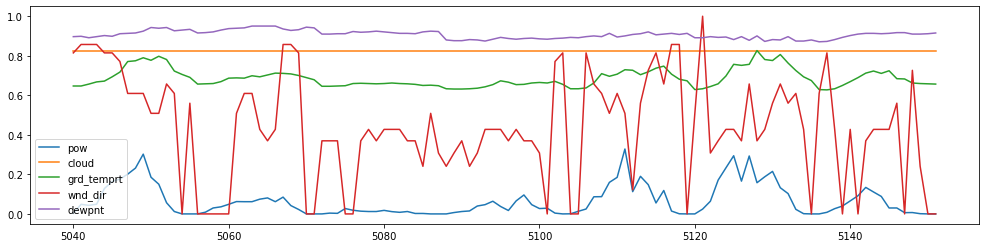

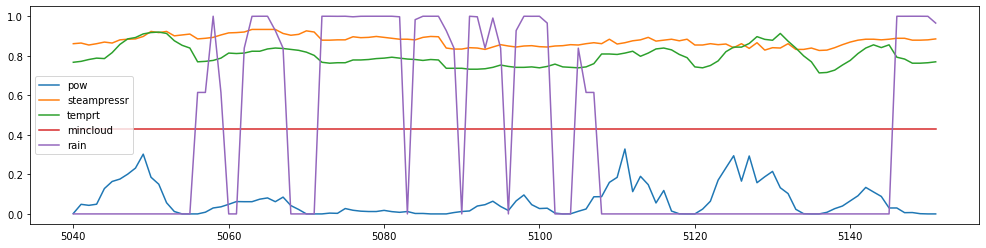

************************************************************************************************************************


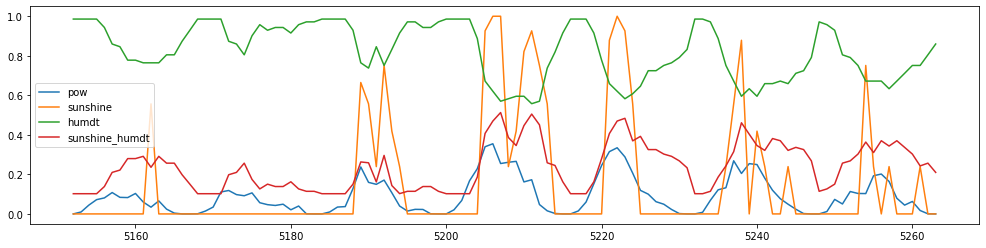

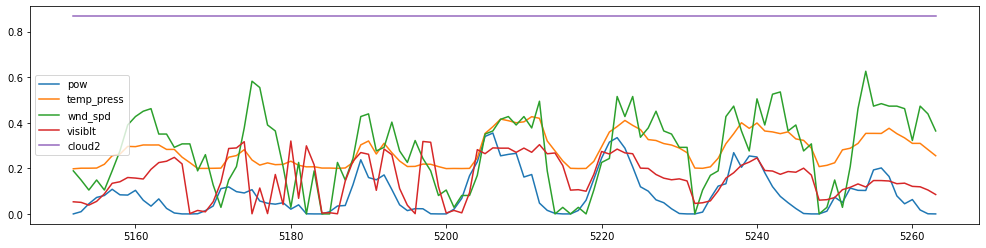

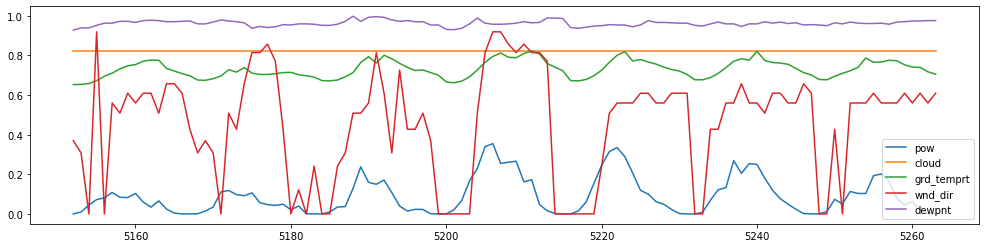

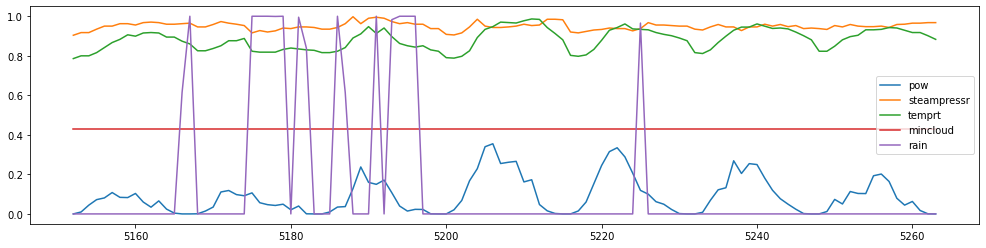

In [104]:
step = hoursteps*7

idx = (int)(np.round(data_dim/4,0))
print("data_dim : ",data_dim, ", idx : ", idx)

plot_dataset1 = df.iloc[:,:idx]
plot_dataset2 = df.iloc[:,idx:idx*2]
plot_dataset3 = df.iloc[:,idx*2:idx*3]
plot_dataset4 = df.iloc[:,idx*3:idx*4]
plot_dataset2.insert(0,'pow',df.iloc[:,0])
plot_dataset3.insert(0,'pow',df.iloc[:,0])
plot_dataset4.insert(0,'pow',df.iloc[:,0])

for i in range(0, plot_dataset1.shape[0]-step, step):
    plt.rcParams["figure.figsize"] = (17,4)
    plot_dataset1[i:i+step].plot()
    plot_dataset2[i:i+step].plot()
    plot_dataset3[i:i+step].plot()
    plot_dataset4[i:i+step].plot()
    print("************************************************************************************************************************")
    plt.show()
    